<a href="https://colab.research.google.com/github/jomarca11/Django_nvd3/blob/master/TFM_Nowcasting.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from river import drift

## 1.Análisis Exploratorio de los datos.

### 1.1 Carga de datos
Procedemos a cargar el dataset.

In [ ]:
#1.Cargamos los datos
#2. Comprobamos los datos nulos y vemos que no hay ninguno
data_orig = pd.read_csv('C:/Users/jrmr/Master/TFM/PEC3/hungary_chickenpox/hungary_chickenpox.csv')
data_orig['Date'] = pd.to_datetime(data_orig['Date'],format="%d/%m/%Y") # convertimos a fecha

### 1.2 Análisis descriptivo de los datos



In [ ]:
#Comprobamos si hay nulos en los datos
data_orig.isna().sum()

Date        0
BUDAPEST    0
BARANYA     0
BACS        0
BEKES       0
BORSOD      0
CSONGRAD    0
FEJER       0
GYOR        0
HAJDU       0
HEVES       0
JASZ        0
KOMAROM     0
NOGRAD      0
PEST        0
SOMOGY      0
SZABOLCS    0
TOLNA       0
VAS         0
VESZPREM    0
ZALA        0
dtype: int64

####1.2.1 Valores Nulos.
Se Puede comprobar que **no existen ningún valor vacio** en los datos.

In [ ]:
#añadimos el total de todas las ciudades
data_orig['Total_Casos'] = data_orig.sum(axis=1)
data_orig.head()

C:\Users\jrmr\AppData\Local\Temp\ipykernel_8936\3302194850.py:2: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  data_orig['Total_Casos'] = data_orig.sum(axis=1)


,Date,BUDAPEST,BARANYA,BACS,BEKES,BORSOD,CSONGRAD,FEJER,GYOR,HAJDU,...,KOMAROM,NOGRAD,PEST,SOMOGY,SZABOLCS,TOLNA,VAS,VESZPREM,ZALA,Total_Casos
0,2005-01-03,168,79,30,173,169,42,136,120,162,...,57,2,178,66,64,11,29,87,68,1807
1,2005-01-10,157,60,30,92,200,53,51,70,84,...,50,29,141,48,29,58,53,68,26,1407
2,2005-01-17,96,44,31,86,93,30,93,84,191,...,46,4,157,33,33,24,18,62,44,1284
3,2005-01-24,163,49,43,126,46,39,52,114,107,...,54,14,107,66,50,25,21,43,31,1255
4,2005-01-31,122,78,53,87,103,34,95,131,172,...,49,11,124,63,56,7,47,85,60,1478


#### 1.2.2 Número de Instancias y variables.
Con la nueva columna que se ha añadido Total_Casos, que totaliza los valores por cada instancia, tenemos 522 instancias y 22 variables.

In [ ]:
#Revisamos el número de instancias
data_orig.shape

(522, 22)

#### 1.2.3 Outliers.
Revisando todas las provincias, se comprueba que, si que hay outliers que deberían de detectarse cuando se esta procesando el streaming de datos, y evitar entrenar con ellos.

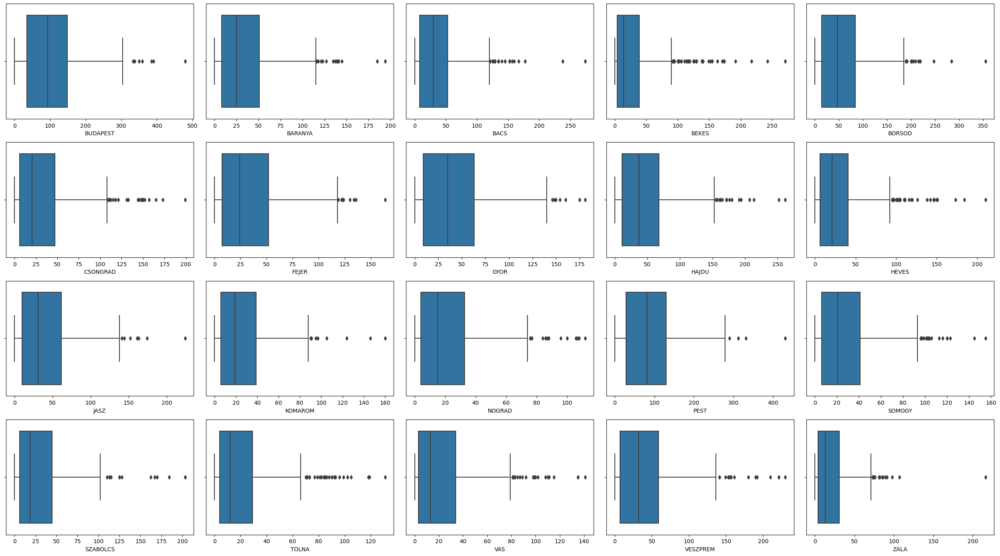

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 1
for row in axes:
    for ax in row:
        x = data_orig.iloc[:, i]
        sns.boxplot(x=x,ax=ax, orient='h')
        i += 1
plt.tight_layout()
plt.show()


#### 1.2.4 Análisis de Estacionalidad.
Hacemos un análisis de la **estacionalidad** de los datos.Se ha creado un campo Total_Casos, para que añada un resumen de todos los datos. A primera vista y para cada provincia, se detecta una estacionalidad en los datos, así mismo en el total de los casos de varicela. Claramente se ve unos picos en los contagios de varicela finales del primer trimestre de cada año y un máximo en el segundo trimestre, decayendo rapidamente en el tercer trimestre, posiblemente por la vacunación o por el clima que empieza a ser mas fresco.Otra factor que pudiera afectar seria el período escolar. En el cuarto trimestre empieza a subir otra vez hasta el segundo trimestre y se vuelve al mismo ciclo de contagios.

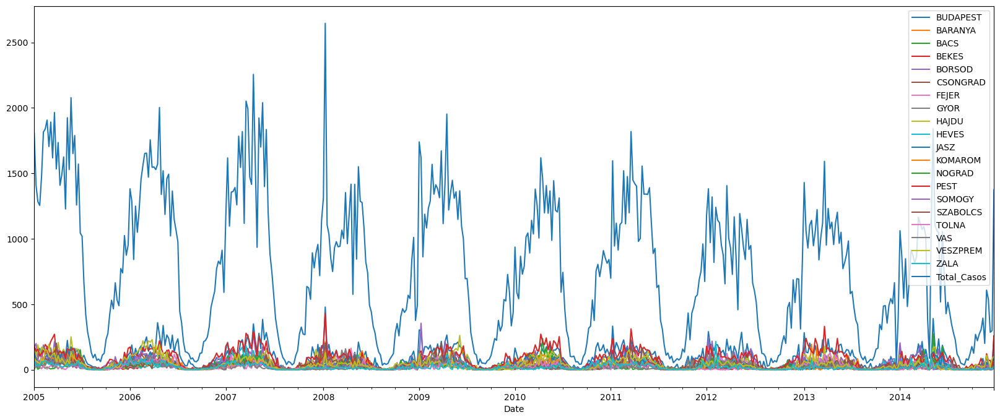

In [ ]:
ax = data_orig.plot(x='Date',  figsize=(20,8))

Primeramente vamos a descomponer la variable Total_Casos,  en estacionalidad, tendencia y la parte de residuos, para obtener una idea general de la estructura de los datos.

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose
data_orig.set_index('Date', inplace=True)

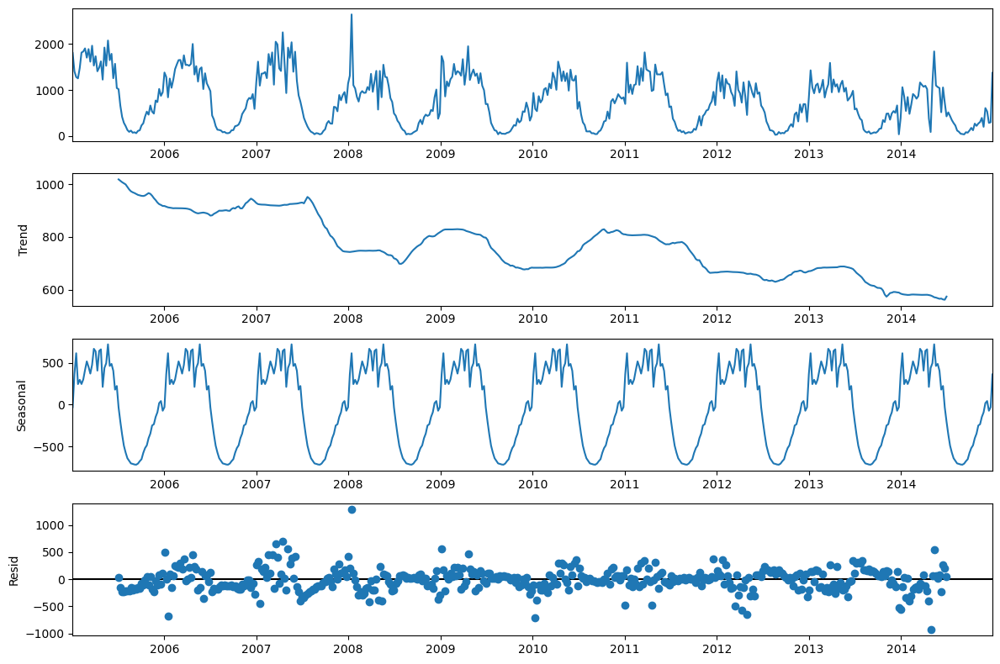

In [ ]:
analysis = data_orig[['Total_Casos']].copy()
decompose_result_mult = seasonal_decompose(analysis, model="additive")
fig = decompose_result_mult.plot();
fig.set_size_inches((12, 8))
fig.tight_layout()
plt.show()


Pasamos a ver la estacionaldad, según cada provincia con más detalle. Viendo las series de  los gráficos individuales, se puede observar lo siguiente:


*   El número de casos reportados depende de la cantidad de población. Aquellas provincias tienen mas población, reportan mas casos.
*   Las series exhiben una grans estacionalidad anual
*   Un gran número de provincias no reportaron ningún caso en verano.   




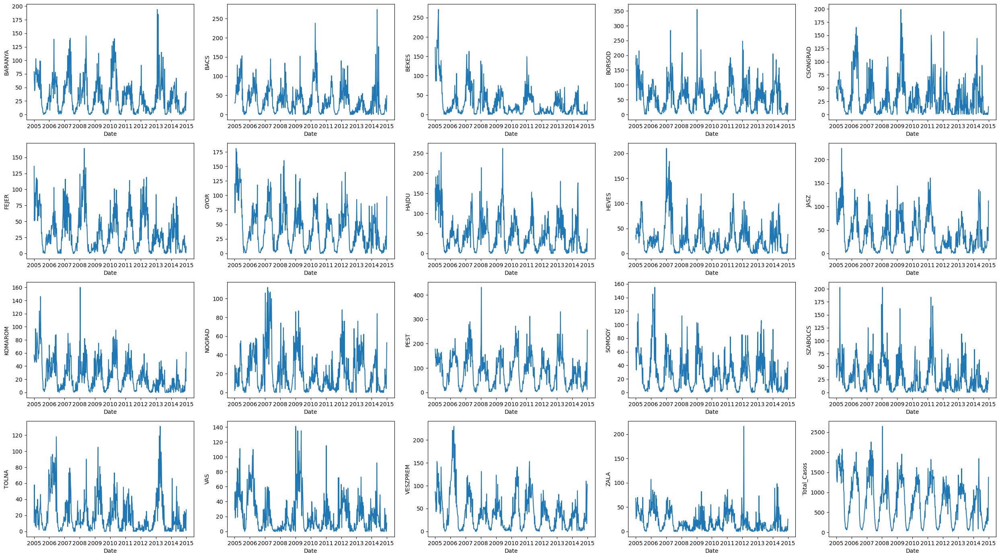

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 1
for row in axes:
    for ax in row:
        x = data_orig.iloc[:, i]
        label=data_orig.columns[i]
        sns.lineplot(x = "Date", y = label, data=data_orig, ax=ax)
        i += 1
plt.tight_layout()
plt.show()

#### 1.2.5 Análisis de Estacionareidad.
Uno de los requisitos para comprobar la Autocorrelación y Correlacion Parcial es que las series sean estacionarias. Se ha utilizado el test de Dickey-Fuller para comprobar que todas las series son estacionarias. Si no fueran estacionarias se deberían de modificar para que sí lo fueran.

In [ ]:
#estacionariedad
from statsmodels.tsa.stattools import adfuller
dict_estacionario={}
Status = "Estacionaria"
col=""
for column in data_orig:
    result = adfuller(data_orig[column])
    if (result[1] <= 0.05) & (result[4]['5%'] > result[0]):
           # print("\u001b[32mStationary\u001b[0m")
           #Status= "Estacionaria"
           dict_estacionario[column]="Serie Estacionaria"
    else:
          #print("\x1b[31mNon-stationary\x1b[0m")
          #Status ="No Estacionaria"
          #col=column
          #break
          dict_estacionario[column]="Serie No Estacionaria"

# Iterate over key/value pairs in dict and print them
for key, value in dict_estacionario.items():
    print(key, ' : ', value)

BUDAPEST  :  Serie Estacionaria
BARANYA  :  Serie Estacionaria
BACS  :  Serie Estacionaria
BEKES  :  Serie Estacionaria
BORSOD  :  Serie Estacionaria
CSONGRAD  :  Serie Estacionaria
FEJER  :  Serie Estacionaria
GYOR  :  Serie Estacionaria
HAJDU  :  Serie Estacionaria
HEVES  :  Serie Estacionaria
JASZ  :  Serie Estacionaria
KOMAROM  :  Serie Estacionaria
NOGRAD  :  Serie Estacionaria
PEST  :  Serie Estacionaria
SOMOGY  :  Serie Estacionaria
SZABOLCS  :  Serie Estacionaria
TOLNA  :  Serie Estacionaria
VAS  :  Serie Estacionaria
VESZPREM  :  Serie Estacionaria
ZALA  :  Serie Estacionaria
Total_Casos  :  Serie Estacionaria


#### 1.2.6 AutoCorrelation and Partial Autocorrelation. 
Vemos un modelo de Autocorrelacion que nos indica un modelo estacional por la forma sinusiode de la gráfica para cada provincia.
Viendo también el gráfico de la Correlación Parcial donde hay pocos valores por encima de la zona de confianza, se podrían modelar las series con un modelo Auto Regresivo (AR), de orden 3. 

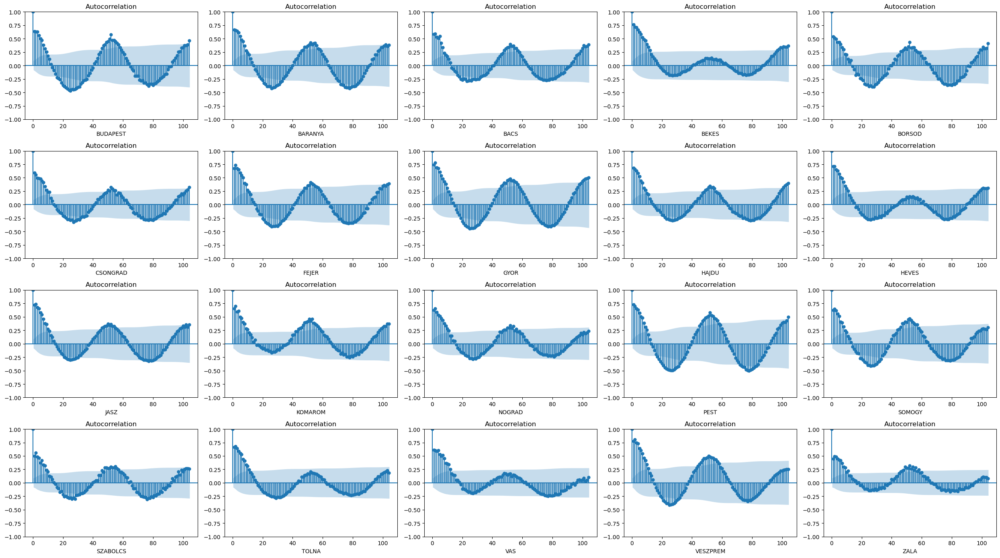

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        x = data_orig.iloc[:, i]
        label=data_orig.columns[i]
        ax.set_xlabel(label)
        fig = plot_acf(x, lags=104, ax=ax)
        i += 1
plt.tight_layout()
plt.show()


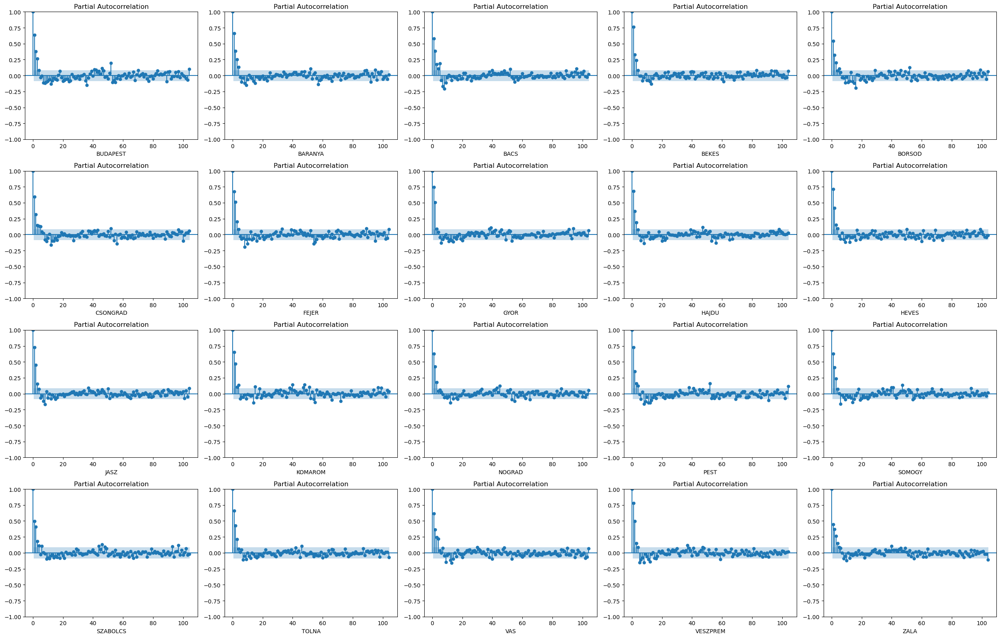

In [ ]:
from statsmodels.graphics.tsaplots import plot_pacf
from statsmodels.graphics.tsaplots import plot_acf
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 16))
i = 0
for row in axes:
    for ax in row:
        x = data_orig.iloc[:, i]
        label=data_orig.columns[i]
        ax.set_xlabel(label)
        fig = plot_pacf(x, lags=104, ax=ax, method="ywmle",) 
        i += 1
plt.tight_layout()
plt.show()


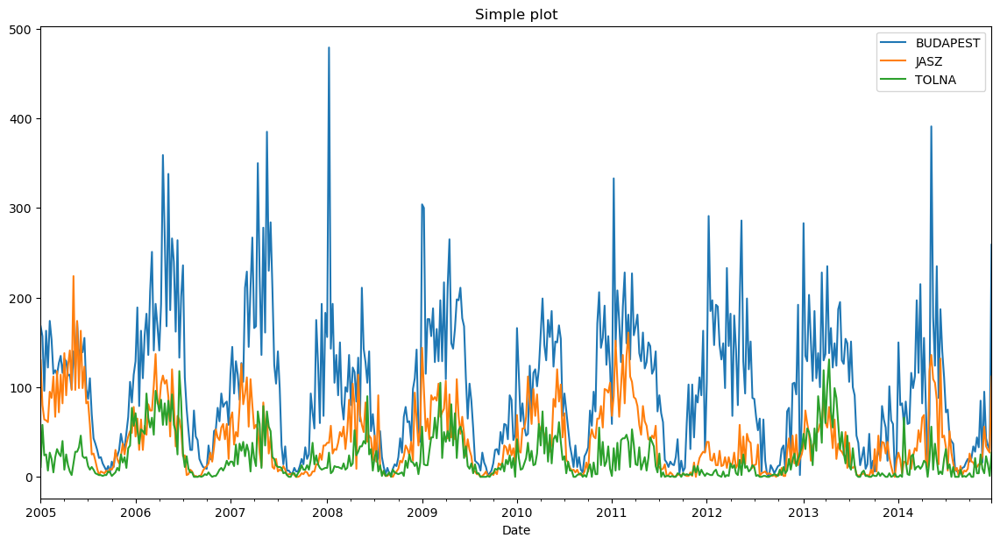

In [ ]:
fig, ax = plt.subplots( figsize=(14, 7))
ax.set_title('Simple plot')
df_BUDAPEST = data_orig[['BUDAPEST']].copy()
df_BUDAPEST.plot(ax=ax)

df_JASZ = data_orig[['JASZ']].copy()
df_JASZ.plot(ax=ax)

df_TOLNA = data_orig[['TOLNA']].copy()
df_TOLNA.plot(ax=ax)

plt.show()


#### 1.2.7 Resumen:
Tenemos unas series Temporales que presentan las siguientes características:


*   Presentan una **correlación temporal**: El número de casos de una semana esta corelacionado con el número de casos de semanas anteriores.
*   Presentan una estacionalidad anual muy fuerte.
*   Presentan un número de casos dependiente del tamaño y población de la provincia..
*   Las Series son estacionarias con lo que se pueden modelar usando modelos de Regresion (AR), viendo sus gráficos de AutoCorrelación y AutoCorrelación Parcial



# 2.Tareas Predictivas 

## 2.1 Corto Plazo (Nowcasting)
En este apartado vamos a realizar las tareas relacionadas con el Nowcasting

In [ ]:
#Nowcasting con todos los regresores
from river import compose
from river import linear_model,tree
from river import preprocessing
from river import metrics, stats,optim
from river import utils,dummy
import pandas as pd

import matplotlib.pyplot as plt
import calendar,math
label_num_casos ="Num. Casos"


class StatisticRegressor(dummy.StatisticRegressor):
  # this method has to be overriden because of the first element, if it is None, then return something, 0 in this case
    def predict_one(self, x):
        yp = super().predict_one(x)
        if yp is None:
            return 0
        return yp

df_datos=pd.DataFrame(columns=data_orig.columns)

#Dataframes para recoger los errores y mostrarlos en las gráficas sin tener en cuenta los outliers
df_error_mae_baseline=pd.DataFrame(columns=data_orig.columns)
df_error_mae_linear=pd.DataFrame(columns=data_orig.columns)
df_error_mae_hft=pd.DataFrame(columns=data_orig.columns)
df_error_mae_stg=pd.DataFrame(columns=data_orig.columns)

#Dataframes para recoger los errores y mostrarlos en las gráficas considerando los outliers
df_error_mae_baseline_sin_outliers=pd.DataFrame(columns=data_orig.columns)
df_error_mae_linear_sin_outliers=pd.DataFrame(columns=data_orig.columns)
df_error_mae_hft_sin_outliers=pd.DataFrame(columns=data_orig.columns)
df_error_mae_stg_sin_outliers=pd.DataFrame(columns=data_orig.columns)

#Dataframes para recoger los errores considerando el Concept Drift
df_error_mae_baseline_concept=pd.DataFrame(columns=data_orig.columns)
df_error_mae_linear_concept=pd.DataFrame(columns=data_orig.columns)
df_error_mae_hft_concept=pd.DataFrame(columns=data_orig.columns)
df_error_mae_stg_concept=pd.DataFrame(columns=data_orig.columns)

def get_ordinal_date(x):
   
    return {'ordinal_date': x.toordinal()}
    
def get_month(x):
    """Returns name of the month of a given x date
    """ 
    return {
        calendar.month_name[month]: month ==  pd.to_datetime(x).month
        for month in range(1, 13)
    }

def get_month_distances(x):
    return {
        calendar.month_name[month]: math.exp(-(x.month - month) ** 2)
        for month in range(1, 13)
    }

model_statistic_regressor = compose.Pipeline(
    ('ordinal_date', compose.FuncTransformer(get_ordinal_date)),
    ('scale', preprocessing.StandardScaler()),
    #('static_reg', dummy.StatisticRegressor(utils.Rolling( stats.Mean(), window_size=10)))
    ('statistic_reg', StatisticRegressor (stats.Shift(1))) #Consejo de Txus,empezar por algo sencillo y sin ventana ya que los demas no tienen ventana
)

model_lin_reg = compose.Pipeline(
    ('ordinal_date', compose.FuncTransformer(get_ordinal_date)),
    ('scale', preprocessing.StandardScaler()),
    ('lin_reg', linear_model.LinearRegression(optimizer=optim.SGD(0.07))) #habria que tener en cuenta el lr_intercep
)

model_hft_reg = compose.Pipeline(
    ('ordinal_date', compose.FuncTransformer(get_ordinal_date)),
    ('scale', preprocessing.StandardScaler()),
    #('HFT_reg', tree.HoeffdingTreeRegressor(grace_period=1,leaf_prediction ="adaptive",model_selector_decay=0.7,min_samples_split=5)) 
   ('HFT_reg', tree.HoeffdingTreeRegressor(grace_period=20,leaf_prediction ="model", leaf_model=linear_model.LinearRegression(optimizer=optim.SGD(0.08)))) 
)

model_stg_reg = compose.Pipeline(
    ('ordinal_date', compose.FuncTransformer(get_ordinal_date)),
    ('scale', preprocessing.StandardScaler()),
    ('SGT_reg', tree.SGTRegressor(gamma=0.5,grace_period=1,delta=0.1,lambda_value=0.2,feature_quantizer=tree.splitter.DynamicQuantizer(std_prop=0.8))) #SE ha tenido que parametrizar si no elresultado era malísimo
)

def evaluate_model(model,df_data,column,ax,etiqueta,check_drift=False, check_outliers=False, is_data_drifted=False): 
    """Calculate the metrics of the model and  model learning  without excluding outliers
       @check_drift: Boolean to check if we need to plot drifts or not
       @etiqueta: kind of model used [linear, stg, hft, statistic]
       @check_outliers: flag to see if checking outliers is needed or not
       @is_data_drifted: boolean, indicates wether the data is drifted or not. Helps to check the message in df_datos
    """
    metric = utils.Rolling(metrics.MAE(), 52)#52 semanas tiene el año que es un ciclo completo
    drifts=[]
    dates = []
    y_trues = []
    y_preds = []
    std=df_data.std()
    mean=df_data.mean()
    outlier_value= mean+(3*std)
    if is_data_drifted :
      mensaje="3 MAE Datos con drift y sin usar adaptacion al drift"
    elif check_outliers:
      mensaje="2 MAE Datos sin drift y tratando outliers"
    else:
      mensaje ="1 MAE Datos sin drift y sin tratar outliers"
    #print (mensaje)
    #Inicializamos el detector de Drift, aqui solo queremos el drift para marcar las líneas verticales
    drift_detector = drift.ADWIN()
  
    i=0 #valor para añadir filas a los dataframes
    for x, y in df_data.T.iteritems():
      #Comprobamos si hay hay algun dríft. Lo añadimos a la lista para pintar la linea vertical
      if check_drift:
        drift_detector.update(y)
        if drift_detector.drift_detected:
           drifts.append(x)
      if  (check_outliers and y> outlier_value) :# Get rid  off outliers
        None
      else: #Trabajamos normalemente
        # Obtain the prior prediction and update the model in one go
        y_pred = model.predict_one(x)
              
        model.learn_one(x, y)
        # Update the error metric
        metric.update(y, y_pred)

        #get metric value for plotting
        if check_outliers==False:
          if etiqueta=="linear":
            df_error_mae_linear.at[i,column] =metric.get()
          elif etiqueta=='stg':
            df_error_mae_stg.at[i,column] =metric.get()
          elif etiqueta=='hft':
            df_error_mae_hft.at[i,column] =metric.get()
          elif etiqueta=='base_line':
            df_error_mae_baseline.at[i,column] =metric.get()
        else:
          if etiqueta=="linear":
            df_error_mae_linear_sin_outliers.at[i,column] =metric.get()
          elif etiqueta=='stg':
            df_error_mae_stg_sin_outliers.at[i,column] =metric.get()
          elif etiqueta=='hft':
            df_error_mae_hft_sin_outliers.at[i,column] =metric.get()
          elif etiqueta=='base_line':
            df_error_mae_baseline_sin_outliers.at[i,column] =metric.get()

        i=i+1
        
        # Store the true value and the prediction
        dates.append(x)
        y_trues.append(y)
        y_preds.append(y_pred)
          
    
    # Plot the results
    # fig, ax = plt.subplots(figsize=(9, 5))
    value=round(metric.get(),2)
    
    if drifts is not None and check_drift:
      for drift_detected in drifts:
              ax.axvline(drift_detected, color='red')
    ax.grid(alpha=0.75)
    ax.plot(dates, y_trues, lw=3, color='#2ecc71', alpha=0.8, label='Ground truth')
    ax.plot(dates, y_preds, lw=3, color='#e74c3c', alpha=0.8, label='Prediction')
    ax.legend()
    ax.set_title(metric) 
    ax.set_xlabel(column)
    ax.set_ylabel(label_num_casos)

    #Añadimos filas con los datos para cada columna
    df_datos.at['Num Registros', column] = len(df_data)
    df_datos.at[mensaje+ ' '+etiqueta, column] = value
    
  

def evaluate_model_without_outliers(model,df_data,column,ax,etiqueta): 

    """Calculate the metrics of the model and  model learning excluding outliers, but considering drift
        @etiqueta: kind of model used [linear, stg, hft, statistic]
    """
    metric = utils.Rolling(metrics.MAE(), 52)#52 semanas tiene el año que es un ciclo completo
    dates = []
    y_trues = []
    y_preds = []
    drifts = []
    std=df_data.std()
    mean=df_data.mean()
    outlier_value= mean+(3*std)

    #Contador de outliers
    num_outliers=0

    #Inicializamos el detector de Drift
    drift_detector = drift.ADWIN()

    #contador de Drifts
    num_drifts = 0 
    i=0
   # print ("columna", column)
    #print ("num_drifts ",num_drifts)
    for x, y in df_data.T.iteritems():
     
      # Obtain the prior prediction and update the model in one go
       
      drift_detector.update(y)
      if not drift_detector.drift_detected:
        if  (y<=outlier_value) :# Get rid  off outliers
          y_pred = model.predict_one(x)
          model.learn_one(x, y)
          # Update the error metric
          metric.update(y, y_pred)

          #get metric value for plotting
          #print ("i ",i)
          if etiqueta=="linear":
            df_error_mae_linear_concept.at[i,column] =metric.get()
          elif etiqueta=='stg':
            df_error_mae_stg_concept.at[i,column] =metric.get()
          elif etiqueta=='hft':
            df_error_mae_hft_concept.at[i,column] =metric.get()
          elif etiqueta=='base_line':
            df_error_mae_baseline_concept.at[i,column] =metric.get()

                  
          # Store the true value and the prediction
          dates.append(x)
          y_trues.append(y)
          y_preds.append(y_pred)
          i=i+1
        #  print ("num_drifts if",num_drifts)
        else:
         num_outliers=num_outliers+1
        
      else:
        num_drifts=num_drifts+1
        model=model.clone() #reiniciamos el modelo y el detector de drift
        drift_detector = drift.ADWIN()
        drifts.append(x)
        
        # print ("num_drifts else",num_drifts)
        # print(f"Change detected at index {i}, input value: {y}")
         
         
      # Plot the results
  # fig, ax = plt.subplots(figsize=(9, 5))
    value=round(metric.get(),2)
    

    if drifts is not None:
      for drift_detected in drifts:
              ax.axvline(drift_detected, color='red')
    ax.grid(alpha=0.75)
    ax.plot(dates, y_trues, lw=3, color='#2ecc71', alpha=0.8, label='Ground truth')
    ax.plot(dates, y_preds, lw=3, color='#e74c3c', alpha=0.8, label='Prediction')
    ax.legend()
    ax.set_title(metric) 
    ax.set_xlabel(column)
    ax.set_ylabel(label_num_casos)
    #Añadimos filas con los datos para cada columna, esto es para hacer una tabla resumen. Ya veremos como
    # print ("num_drifts total",num_drifts)
  
    df_datos.at['STD', column] = round(std,2)
    df_datos.at['MEAN', column] = round(mean,2)
    df_datos.at['Num Outliers', column] = num_outliers
    df_datos.at['Num Drifts', column] = num_drifts
    df_datos.at['4 MAE usando deteccion y adaptacion al drift_'+etiqueta, column] = value
    


### 2.1.1 Graficas y Nowcasting con los diferentes modelos.
En este apartado se muestra la evolución del error, MAE,  con respecto a los valores reales y sus predicciones, para cada una de las ciudades y modelo respectivo.

#### 2.1.1.1 Hoeffding Tree Regressor.
En este apartado mostraremos el comportamiento del modelo.

##### 2.1.1.1.1 Hoeffding Tree Regressor, sin tratar los outliers

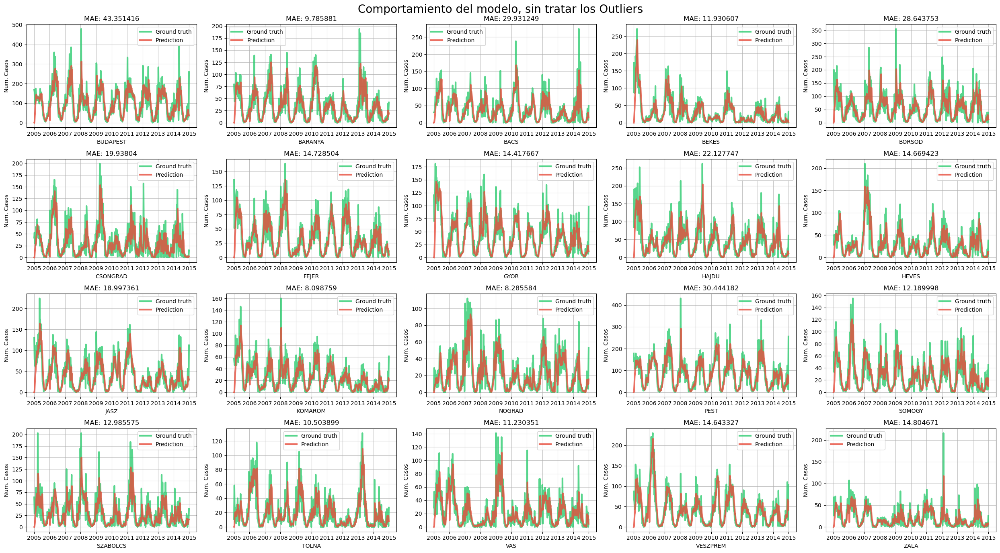

In [ ]:
#Hoeffding Tree Regressor Model
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        label=data_orig.columns[i]
        evaluate_model(model_hft_reg.clone(),df_data,label,ax,etiqueta="hft",check_drift=False,check_outliers=False,is_data_drifted=False)
        i += 1
fig.suptitle("Comportamiento del modelo, sin tratar los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.1.1.1.2 Hoeffding Tree Regressor, tratando los outliers

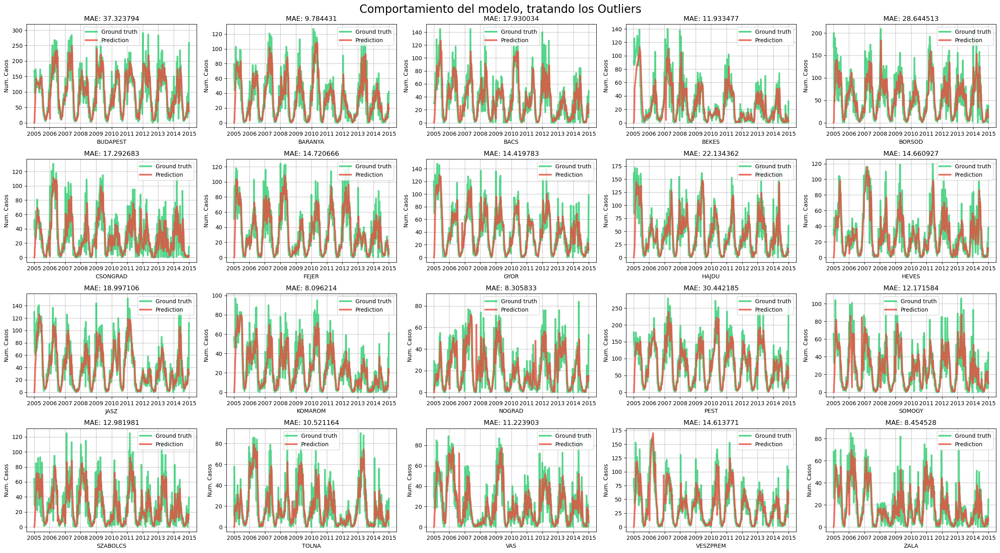

In [ ]:
#Hoeffding Tree Regressor Model
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        label=data_orig.columns[i]
        evaluate_model(model_hft_reg.clone(),df_data,label,ax,etiqueta="hft",check_drift=False,check_outliers=True,is_data_drifted=False)
        i += 1
fig.suptitle("Comportamiento del modelo, tratando los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.1.1.2 Linear Regressor Model, sin tener en cuenta los outliers.

##### 2.1.1.2.1 Linear Regressor Model, sin tratar los outliers

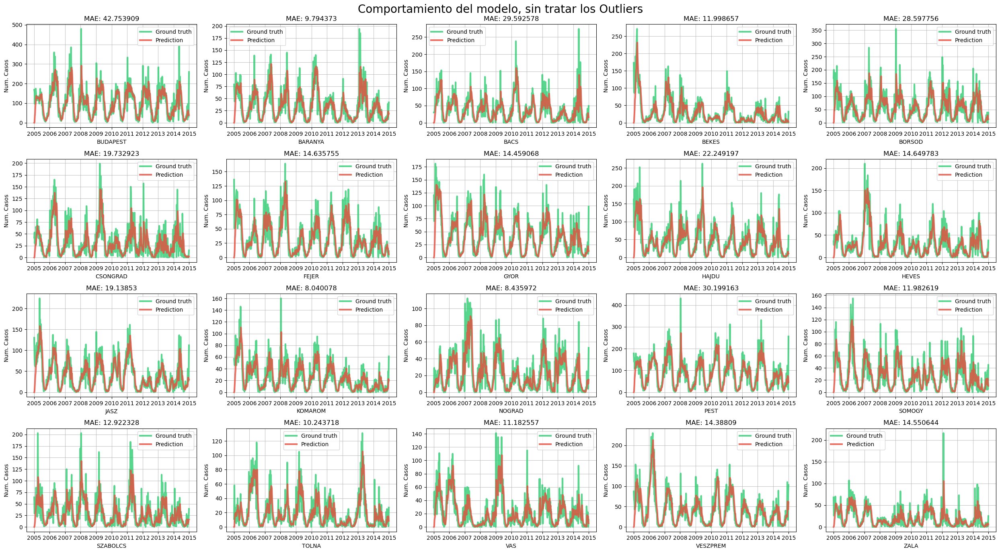

In [ ]:
#Linear Regressor Model
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        label=data_orig.columns[i]
        evaluate_model(model_lin_reg.clone(),df_data,label,ax,etiqueta="linear",check_drift=False,check_outliers=False,is_data_drifted=False)
        i += 1
fig.suptitle("Comportamiento del modelo, sin tratar los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.1.1.2.2 Linear Regressor Model, tratando los outliers.

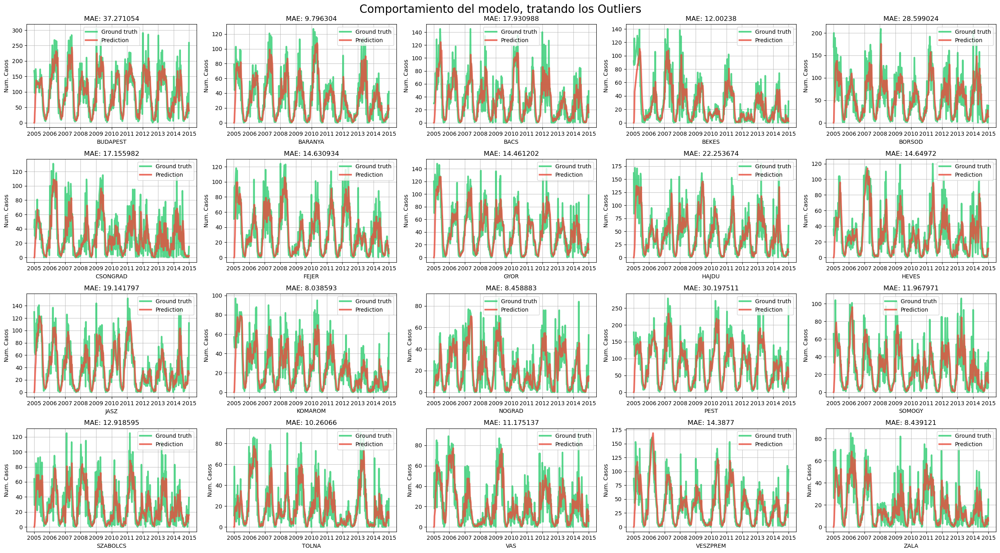

In [ ]:
#Linear Regressor Model
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        label=data_orig.columns[i]
        evaluate_model(model_lin_reg.clone(),df_data,label,ax,etiqueta="linear",check_drift=False,check_outliers=True,is_data_drifted=False)
        i += 1
fig.suptitle("Comportamiento del modelo, tratando los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.1.1.3 SGT Regressor (Stochastic Gradient Tree for Regression) Model.

##### 2.1.1.3.1 SGT Regressor (Stochastic Gradient Tree for Regression) Model, sin tener en cuenta los outliers.

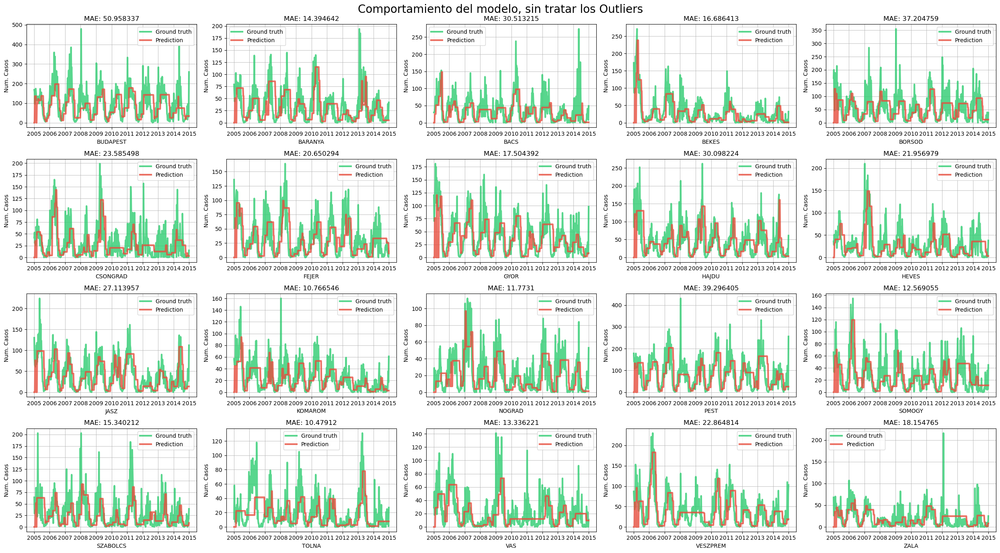

In [ ]:
#evaluate_model(model_stg_reg)
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        label=data_orig.columns[i]
        evaluate_model(model_stg_reg.clone(),df_data,label,ax,etiqueta="stg",check_drift=False,check_outliers=False,is_data_drifted=False)
        i += 1
fig.suptitle("Comportamiento del modelo, sin tratar los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.1.1.3.2 SGT Regressor (Stochastic Gradient Tree for Regression) Model, tratando los outliers.

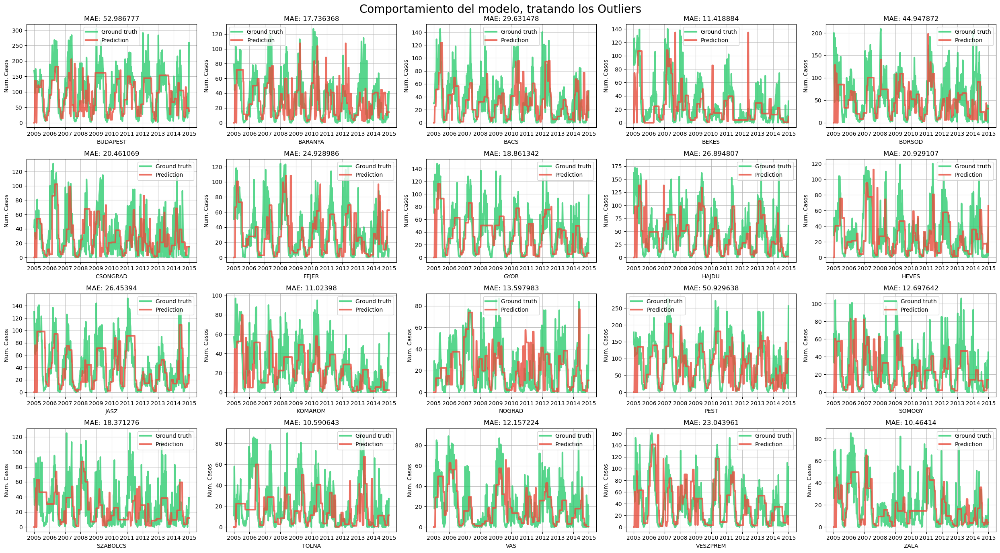

In [ ]:
#evaluate_model(model_stg_reg)
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        label=data_orig.columns[i]
        evaluate_model(model_stg_reg.clone(),df_data,label,ax,etiqueta="stg",check_drift=False,check_outliers=True,is_data_drifted=False)
        i += 1
fig.suptitle("Comportamiento del modelo, tratando los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.1.1.4 Statistic Regressor Mode (Dummy). Devuelve el valor en el instante anterior.

##### 2.1.1.4.1 Statistic Regressor Mode (Dummy). Devuelve el valor en el instante anterior, sin tener en cuenta los outliers.

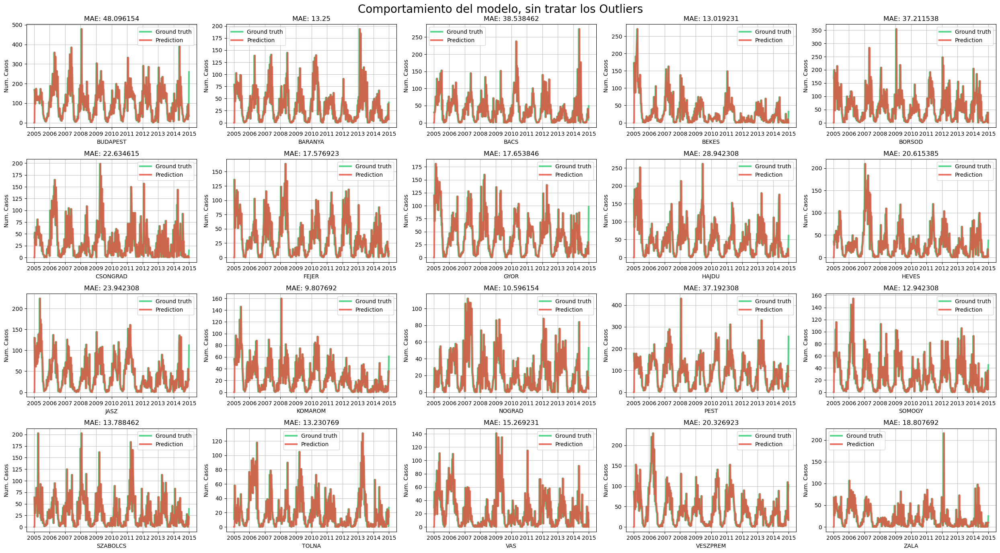

In [ ]:
#evaluate_model(model_statistc_regressor)
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        label=data_orig.columns[i]
        evaluate_model(model_statistic_regressor.clone(),df_data,label,ax,etiqueta="base_line",check_drift=False,check_outliers=False,is_data_drifted=False)
        i += 1
fig.suptitle("Comportamiento del modelo, sin tratar los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.1.1.4.2 Statistic Regressor Mode (Dummy). Devuelve el valor en el instante anterior, tratando los outliers.

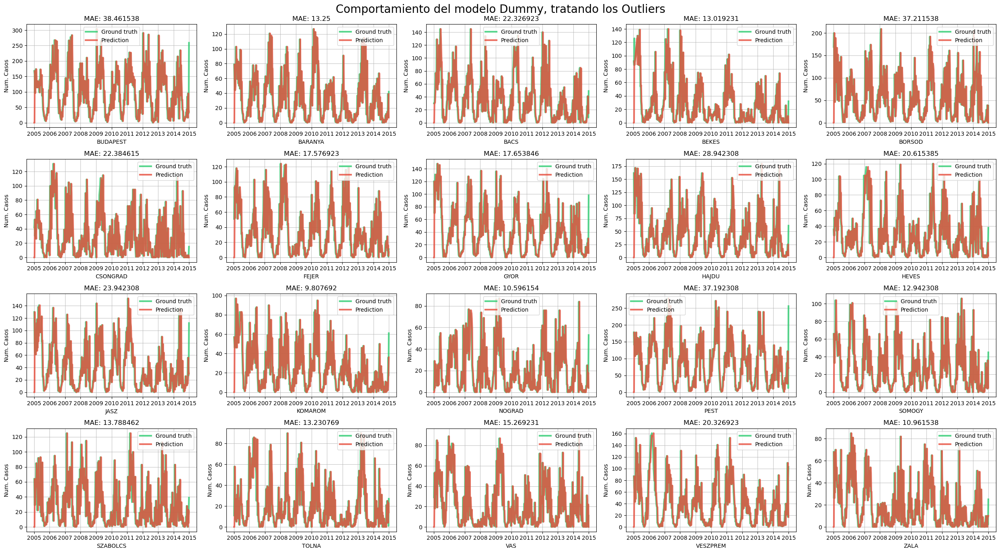

In [ ]:
#evaluate_model(model_statistc_regressor)
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        label=data_orig.columns[i]
        evaluate_model(model_statistic_regressor.clone(),df_data,label,ax,etiqueta="base_line",check_drift=False,check_outliers=True,is_data_drifted=False)
        i += 1
fig.suptitle("Comportamiento del modelo Dummy, tratando los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.1.1.5 Gráficas, comparación de la métrica de error seleccionada (MAE).
Se compara la evolución del error, MAE, de cada uno de los 4 modelos para cada ciudad.Se puede comprobar que de los 4 el mejor modelo es el Linear Regression y el Hoeffing Tree Regressor ya que éste tiene en las hojas un modelo de regresión Lineal (Linear Regressor).Estas dos métricas en las gráficas casi estan solapadas por que soy muy parecidas.

##### 2.1.1.5.1 Graficas, comparación de la métrica de error seleccionada (MAE)con baseline, sin tratat los outliers, para cada ciudad.

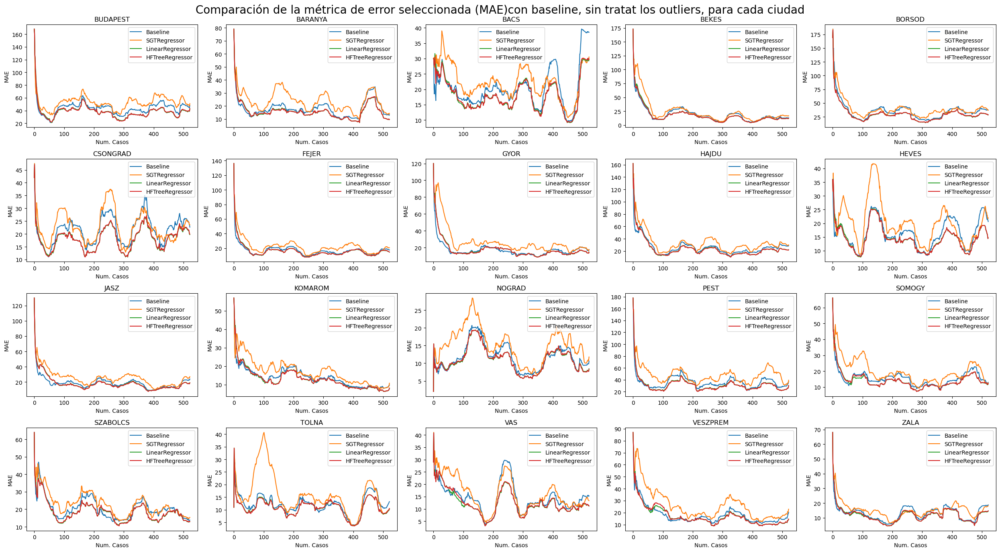

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        label=data_orig.columns[i]
        ax.set_title(label)
        df_error_mae_baseline[label].plot(ax=ax)
        df_error_mae_stg[label].plot(ax=ax)
        df_error_mae_linear[label].plot(ax=ax)
        df_error_mae_hft[label].plot(ax=ax)
        ax.set_xlabel(label_num_casos)
        ax.set_ylabel("MAE")
        ax.legend(["Baseline", "SGTRegressor","LinearRegressor","HFTreeRegressor"]);
        i += 1
fig.suptitle("Comparación de la métrica de error seleccionada (MAE)con baseline, sin tratat los outliers, para cada ciudad", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.1.1.5.2 Graficas, comparación de la métrica de error seleccionada (MAE)con baseline tratando los outliers, para cada ciudad.

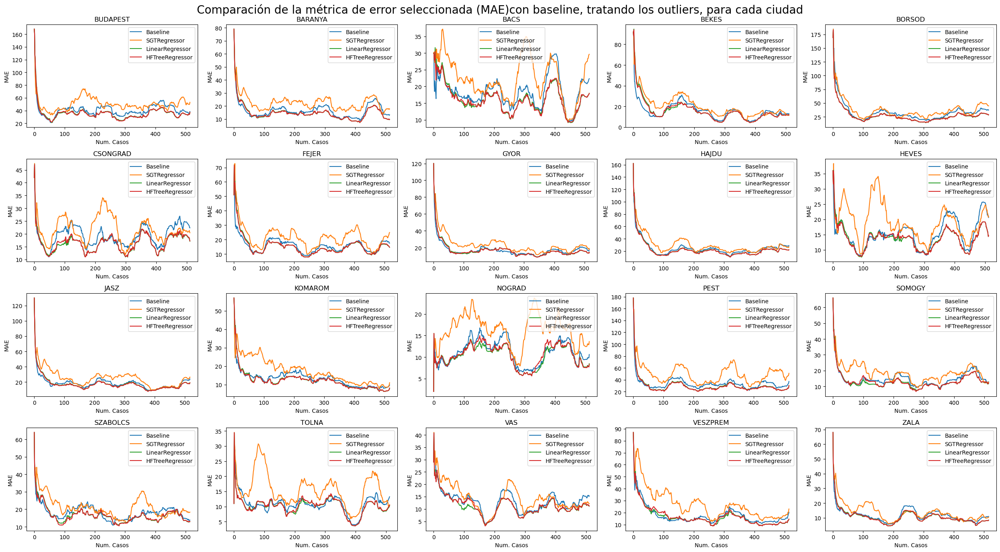

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        label=data_orig.columns[i]
        ax.set_title(label)
        df_error_mae_baseline_sin_outliers[label].plot(ax=ax)
        df_error_mae_stg_sin_outliers[label].plot(ax=ax)
        df_error_mae_linear_sin_outliers[label].plot(ax=ax)
        df_error_mae_hft_sin_outliers[label].plot(ax=ax)
        ax.set_xlabel(label_num_casos)
        ax.set_ylabel("MAE")
        ax.legend(["Baseline", "SGTRegressor","LinearRegressor","HFTreeRegressor"]);
        i += 1
fig.suptitle("Comparación de la métrica de error seleccionada (MAE)con baseline, tratando los outliers, para cada ciudad", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.1.1.6  Graficas de cada regresor **para cada ciudad** comparando la evolución del error tratando los outliers vs sin tratarlor.

###### 2.1.1.6.1  Hoeffding Tree Regressor, comparando la evolución del error Tratando los outliers vs Sin tratarlos.

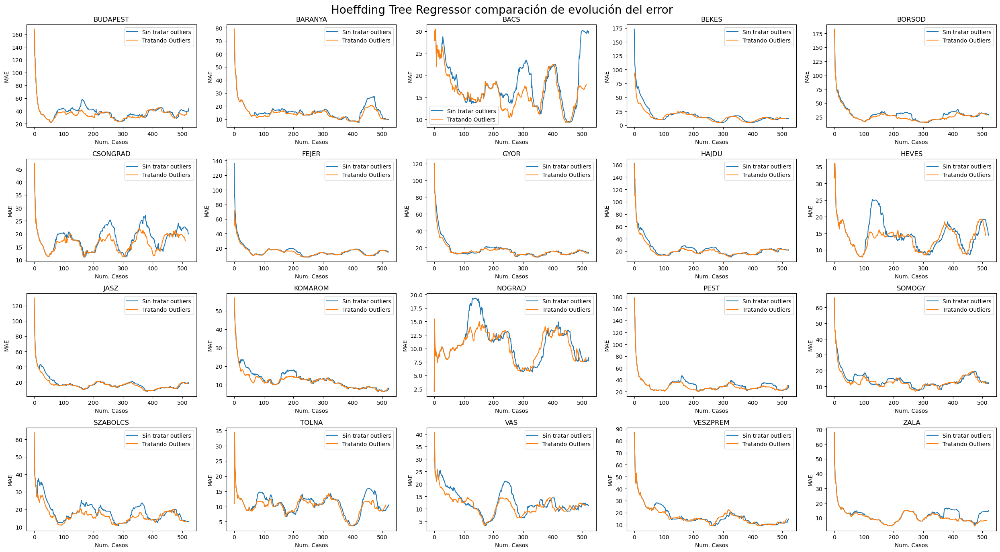

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        label=data_orig.columns[i]
        ax.set_title(label)
        df_error_mae_hft[label].plot(ax=ax)
        df_error_mae_hft_sin_outliers[label].plot(ax=ax)
        ax.legend(["Sin tratar outliers", "Tratando Outliers"]);
        ax.set_xlabel(label_num_casos)
        ax.set_ylabel("MAE")
        i += 1
fig.suptitle(" Hoeffding Tree Regressor comparación de evolución del error", fontsize=20)
plt.tight_layout()
plt.show()

###### 2.1.1.6.2  LinearTree Regressor, comparando la evolución del error Tratando los outliers vs Sin tratarlos.

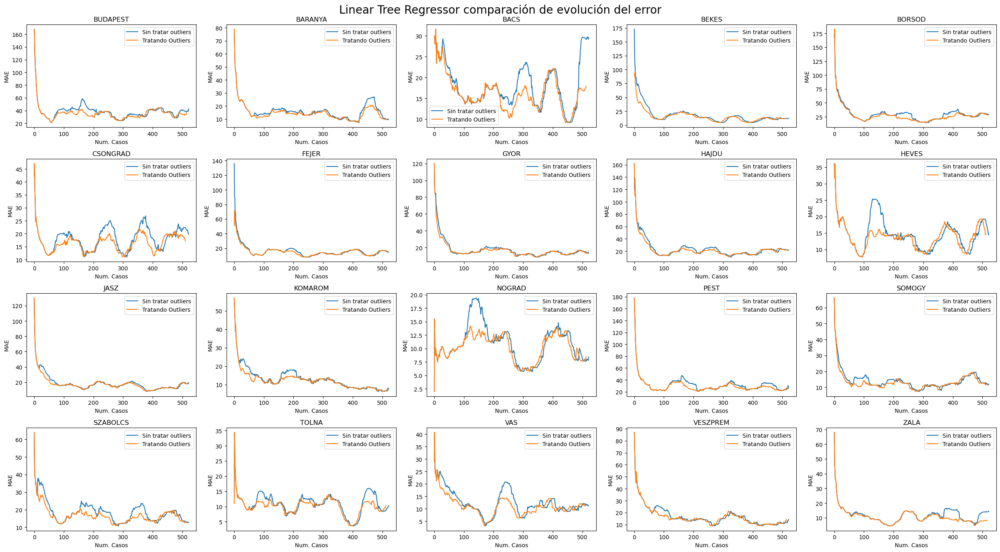

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        label=data_orig.columns[i]
        ax.set_title(label)
        df_error_mae_linear[label].plot(ax=ax)
        df_error_mae_linear_sin_outliers[label].plot(ax=ax)
        ax.legend(["Sin tratar outliers", "Tratando Outliers"]);
        ax.set_xlabel(label_num_casos)
        ax.set_ylabel("MAE")
        i += 1
fig.suptitle("Linear Tree Regressor comparación de evolución del error", fontsize=20)
plt.tight_layout()
plt.show()

###### 2.1.1.6.3  Stochastic Gradient Tree Regressor, comparando la evolución del error Tratando los outliers vs Sin tratarlos.

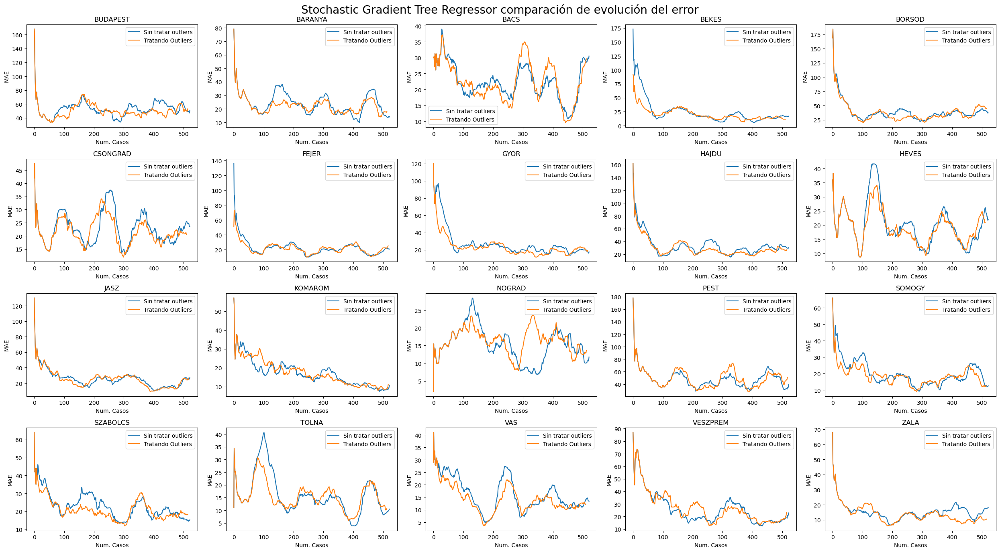

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        label=data_orig.columns[i]
        ax.set_title(label)
        df_error_mae_stg[label].plot(ax=ax)
        df_error_mae_stg_sin_outliers[label].plot(ax=ax)
        ax.legend(["Sin tratar outliers", "Tratando Outliers"]);
        ax.set_xlabel(label_num_casos)
        ax.set_ylabel("MAE")
        i += 1
fig.suptitle("Stochastic Gradient Tree Regressor comparación de evolución del error", fontsize=20)
plt.tight_layout()
plt.show()

###### 2.1.1.6.4  Statistict Regressor (DUMMY), comparando la evolución del error Tratando los outliers vs Sin tratarlos.

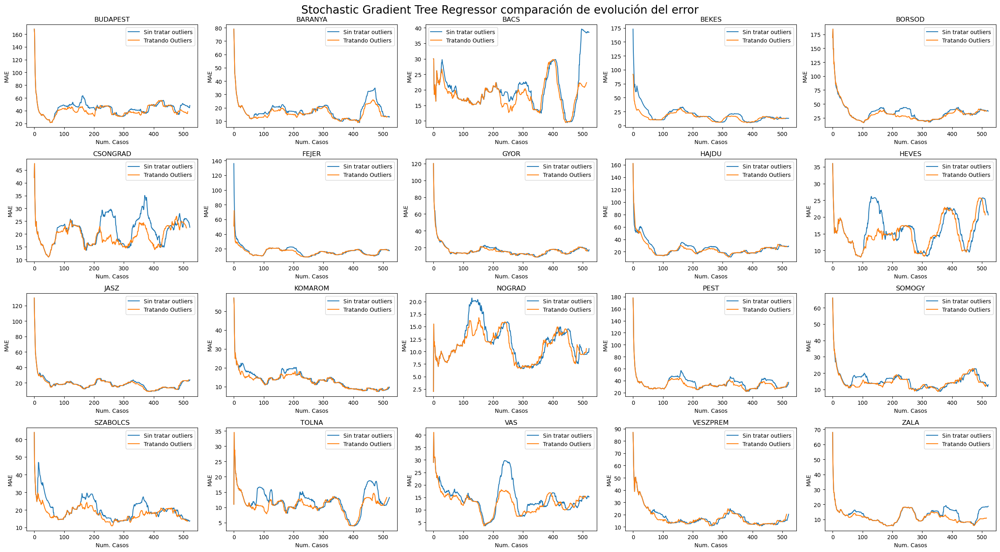

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        label=data_orig.columns[i]
        ax.set_title(label)
        df_error_mae_baseline[label].plot(ax=ax)
        df_error_mae_baseline_sin_outliers[label].plot(ax=ax)
        ax.legend(["Sin tratar outliers", "Tratando Outliers"]);
        ax.set_xlabel(label_num_casos)
        ax.set_ylabel("MAE")
        i += 1
fig.suptitle("Stochastic Gradient Tree Regressor comparación de evolución del error", fontsize=20)
plt.tight_layout()
plt.show()

### 2.1.2 Creando Concept Drift
Se ha incorporado un Concept Drift de forma artificial para ver el comportamiento del algoritmo con los datos de la viruela.

In [ ]:
#Creamos el Concept Drift , para analizar los datos
df_data_orig_drifted=data_orig.copy()
for column in df_data_orig_drifted.columns:
   for index, value in df_data_orig_drifted[column].items(): 
    if (index >=pd.Timestamp('2008-01-01') and index <=pd.Timestamp('2011-12-30') ):
        df_data_orig_drifted[column].at[index]= value *0.3
    


Con las siguientes gráficas, se comprueba que efectivamente se ven los Concept Drifts incorporados mediante unas líneas verticales de color rojo.

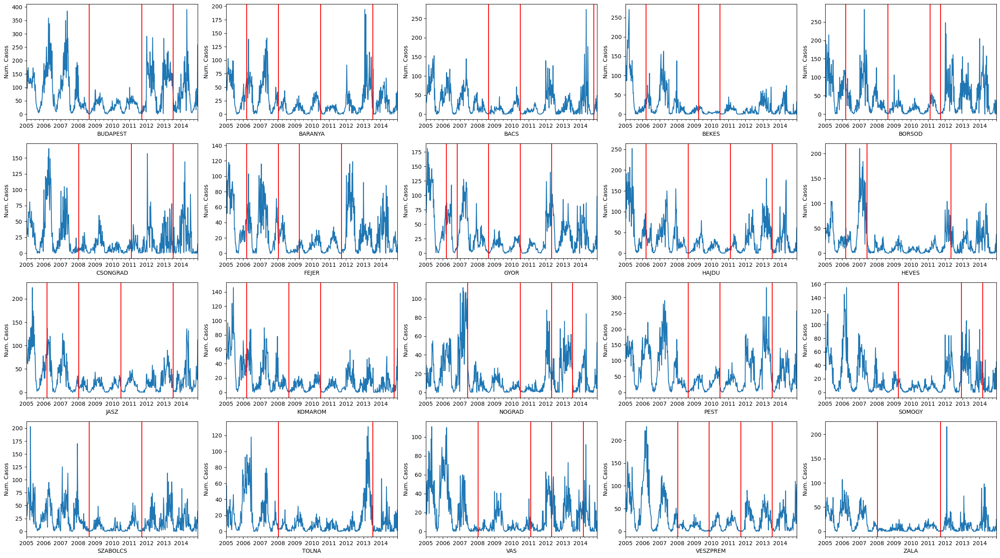

In [ ]:
#Comprobamos que el detector de drift detecta los cambios que hemos introducido mediante gráficas
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        drift_detector = drift.ADWIN()
        df_data= df_data_orig_drifted.iloc[:, i]
        label=df_data_orig_drifted.columns[i]
        df_data.plot(ax=ax)
        for j, val in df_data.items():
            drift_detector.update(val)   # Data is processed one sample at a time
            if drift_detector.drift_detected:
              # The drift detector indicates after each sample if there is a drift in the data
               #print(f'Change detected at index {j}')
                ax.axvline(j, color='red')
        ax.set_xlabel(label)  
        ax.set_ylabel(label_num_casos)
        i += 1
plt.tight_layout()
plt.show()


### 2.1.3 Graficas y Nowcasting con los diferentes modelos, tratando el Concept Drift o no.
En este apartado se muestra la evolución del error, MAE,  con respecto a los valores reales y sus predicciones teniendo en cuenta los outliers y la deteccion del Concep Drift inducido en los datos.

#### 2.1.3.1 Hoeffding Tree Regressor Model.
En este apartado mostraremos el comportamiento del modelo a partir del drift que hemos inducido artificialmente, con un detector de drift como es el ADWIN  y como se comportará el modelo sin un detector de drift. Claramente se puede observar en las gráficas que el error, MAE, es menor cuando se adapta el modelo al drift.

##### 2.1.3.1.1 Hoeffding Tree Regressor, con drift en los datos y usando detección y adaptación al drift



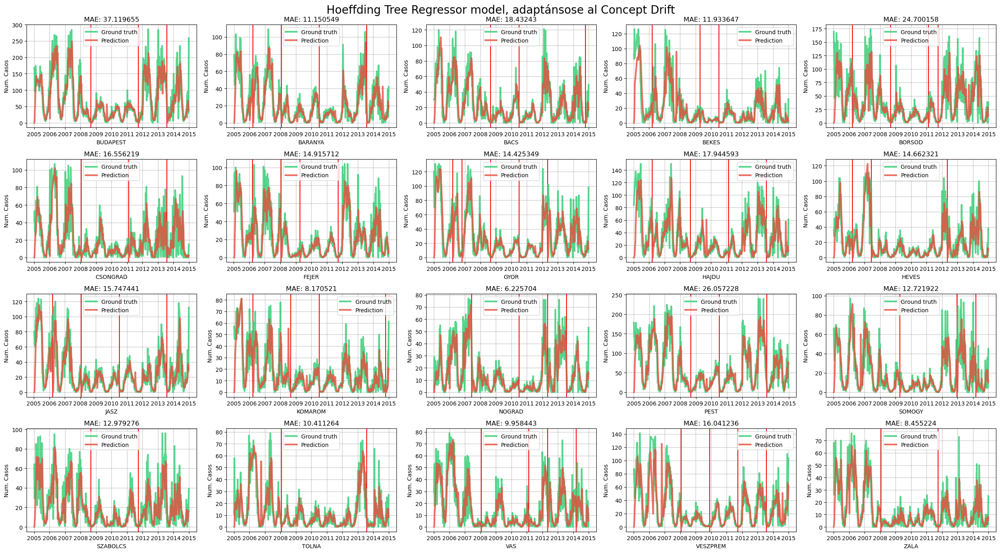

In [ ]:
#evaluate_model(model_hft_reg)
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        label=df_data_orig_drifted.columns[i]
        evaluate_model_without_outliers (model_hft_reg.clone(),df_data,label,ax,"hft")
        i += 1
fig.suptitle("Hoeffding Tree Regressor model, adaptánsose al Concept Drift", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.1.3.1.2 Hoeffding Tree Regressor, con drift en los datos y sin usar detección y adaptación al drift



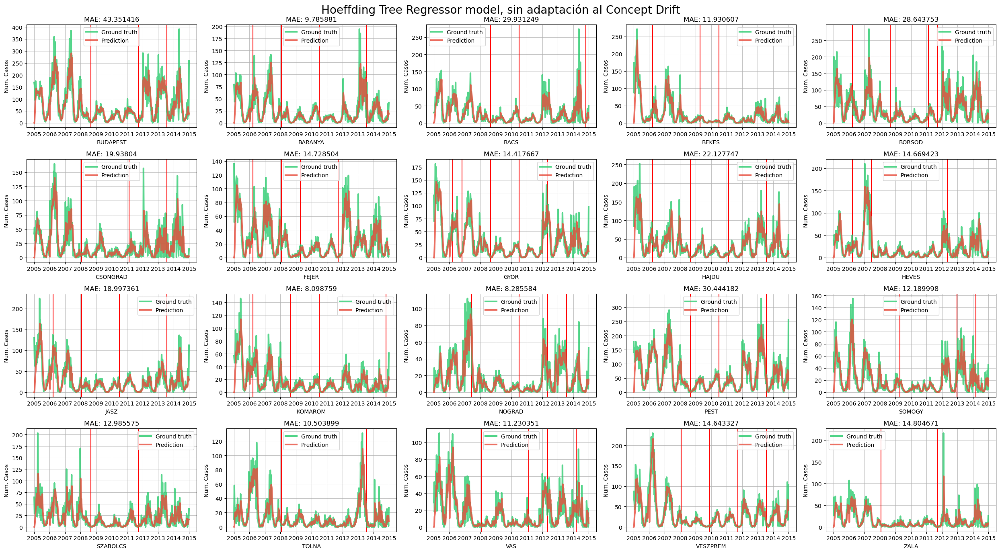

In [ ]:
#evaluate_model(model_hft_reg)
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        label=df_data_orig_drifted.columns[i]
        evaluate_model(model_hft_reg.clone(),df_data,label,ax,etiqueta="hft",check_drift=True,is_data_drifted=True)
        i += 1
fig.suptitle("Hoeffding Tree Regressor model, sin adaptación al Concept Drift", fontsize=20)

plt.tight_layout()
plt.show()

#### 2.1.3.2 Linear Regressor Model
En este caso se comprueba lo mismo con el el Hoeffding Tree Regressor. Al adaptarse al drift, el error es menor que sin adaptación al drift.

##### 2.1.3.2.1 Linear Regressor, con drift en los datos y usando detección y adaptación al drift

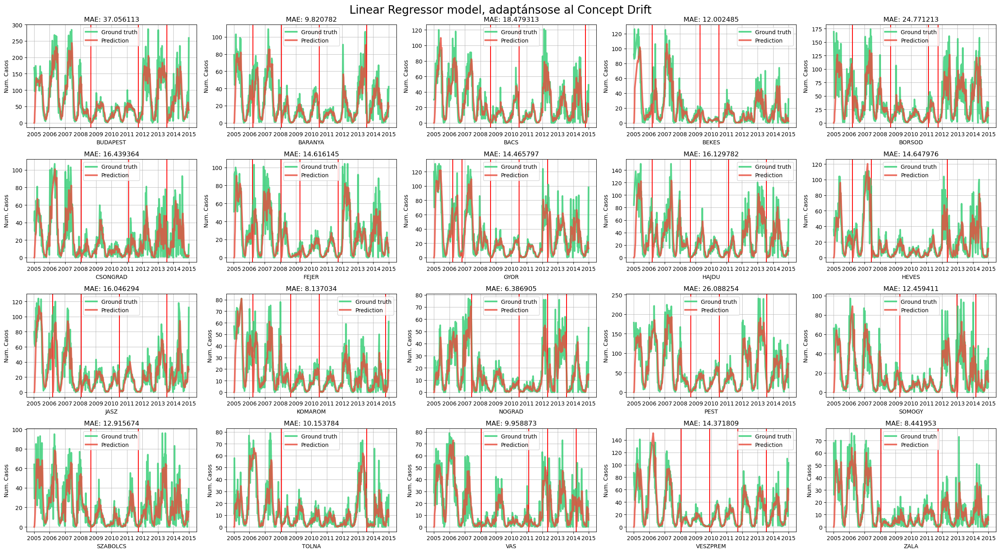

In [ ]:
#Modelo linear Regressor
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        label=df_data_orig_drifted.columns[i]
        evaluate_model_without_outliers(model_lin_reg.clone(),df_data,label,ax,"linear")
        i += 1
fig.suptitle("Linear Regressor model, adaptánsose al Concept Drift", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.1.3.1.2 Linear Regressor, con drift en los datos y sin usar detección y adaptación al drift


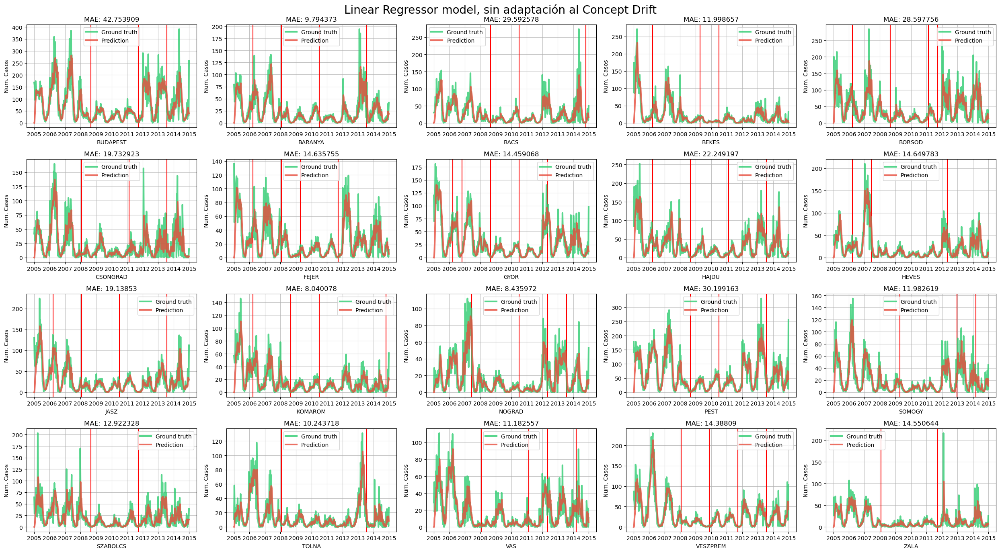

In [ ]:
#Modelo linear Regressor
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        label=df_data_orig_drifted.columns[i]
        evaluate_model(model_lin_reg.clone(),df_data,label,ax,etiqueta="linear",check_drift=True,is_data_drifted=True)
        i += 1
fig.suptitle("Linear Regressor model, sin adaptación al Concept Drift", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.1.3.3 SGT Regressor (Stochastic Gradient Tree for Regression) Model.
Aunque este modelo es el que pero se comporta en general, también se puede comprobar como la adaptación al drift provoca una disminución en el error,MAE, obtenido.

##### 2.1.3.3.1 Stochastic Gradient Tree Regressor, con drift en los datos y usando detección y adaptación al drift.

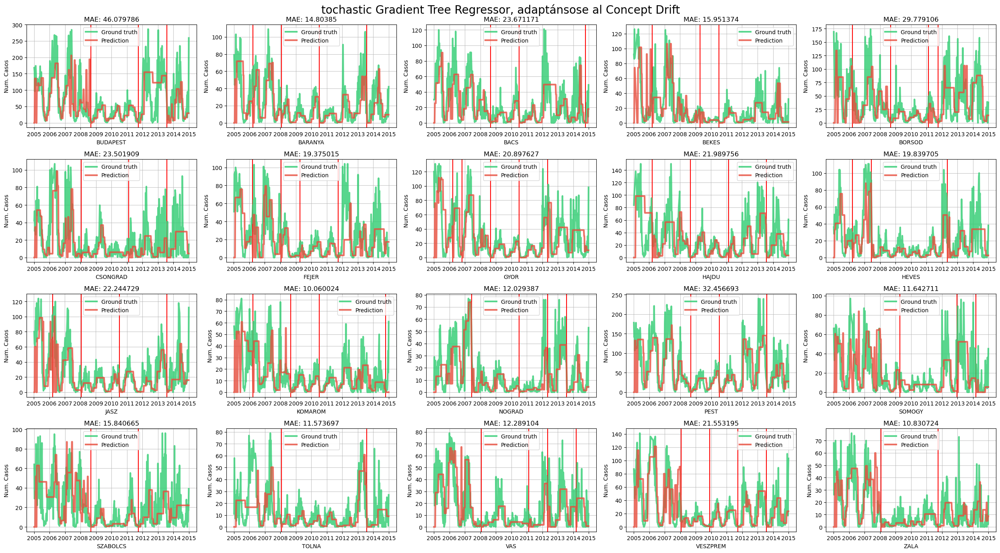

In [ ]:
#evaluate_model(model_stg_reg)
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        label=df_data_orig_drifted.columns[i]
        evaluate_model_without_outliers(model_stg_reg.clone(),df_data,label,ax,"stg")
        i += 1
fig.suptitle("tochastic Gradient Tree Regressor, adaptánsose al Concept Drift", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.1.3.3.2 Stochastic Gradient Tree Regressor, con drift en los datos y sin usar detección y adaptación al drift.

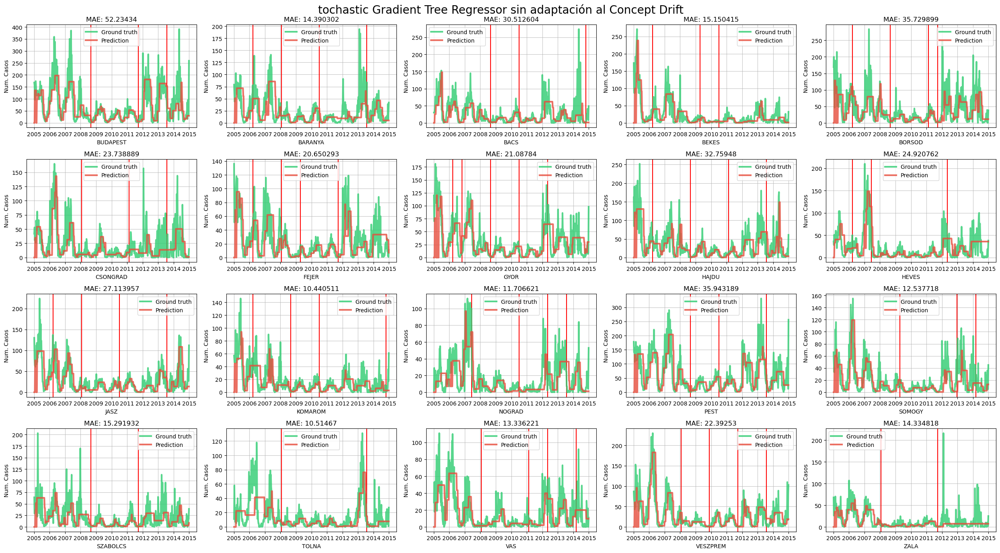

In [ ]:
#evaluate_model(model_stg_reg)
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        label=df_data_orig_drifted.columns[i]
        evaluate_model(model_stg_reg.clone(),df_data,label,ax,etiqueta="stg",check_drift=True,is_data_drifted=True)
        i += 1
fig.suptitle("tochastic Gradient Tree Regressor sin adaptación al Concept Drift", fontsize=20)
plt.tight_layout()
plt.show()

#### 2.1.3.3 Statistic Regressor Model (Dummy). Devuelve el valor en el instante anterior.
Este modelo, simplemente es el "modelo a batir" y aunque su predicción sea simplemente devolver el valor en el instante anterior, se puede comprobar que la adaptación al drift, hace que el error, MAE, sea menor.

##### 2.1.3.3.1 Statistic Regressor, con drift en los datos y usando detección y adaptación al drift.

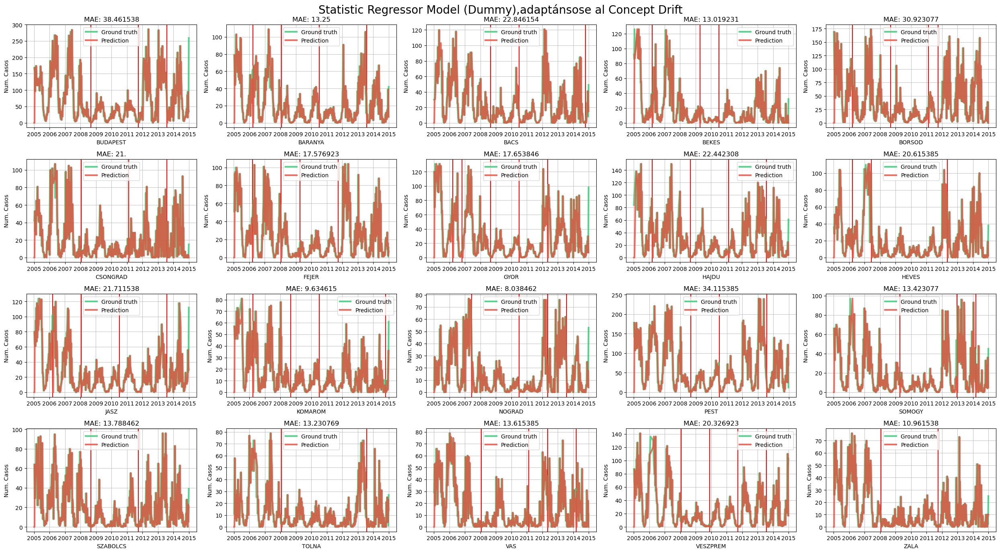

In [ ]:
#Model Statistic Regressor
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        label=df_data_orig_drifted.columns[i]
        evaluate_model_without_outliers(model_statistic_regressor.clone(),df_data,label,ax,"base_line")
        i += 1
fig.suptitle("Statistic Regressor Model (Dummy),adaptánsose al Concept Drift", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.1.3.3.2 Statistic Regressor, con drift en los datos y sin usar detección y adaptación al drift.

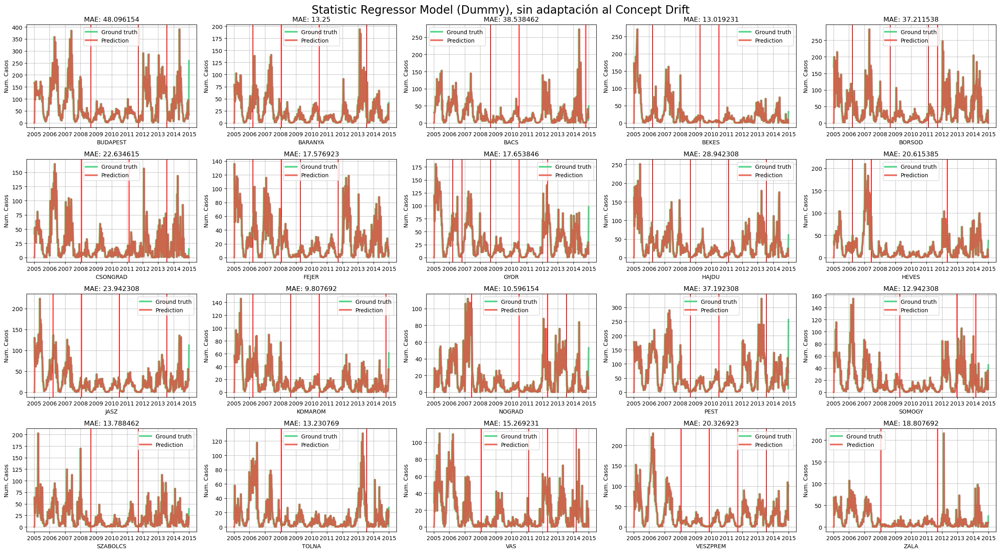

In [ ]:
#Model Statistic Regressor
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:,i]
        label=df_data_orig_drifted.columns[i]
        evaluate_model(model_statistic_regressor.clone(),df_data,label,ax,etiqueta="base_line",check_drift=True,is_data_drifted=True)
        i += 1
fig.suptitle("Statistic Regressor Model (Dummy), sin adaptación al Concept Drift", fontsize=20)
plt.tight_layout()
plt.show()

### 2.1.4  Graficas, comparación de la métrica de error seleccionada (MAE)según los diferentes modelos para cada ciudatd, teniendo en cuenta los outliers y detectando y adaptandose al Concept Drift.
En este apartado se comprueba como los modelos que incorporan un detector de Drift, ante una situación de Concept Drift en los datos, estos se adaptan mejor. Se adaptan antes y con mas suavidad que los modelos sin incorporar detector de drift

##### 2.1.3.4.1 Gráficas de la evolución del error por regresor, con drift en los datos y usando detección y adaptación al drift.

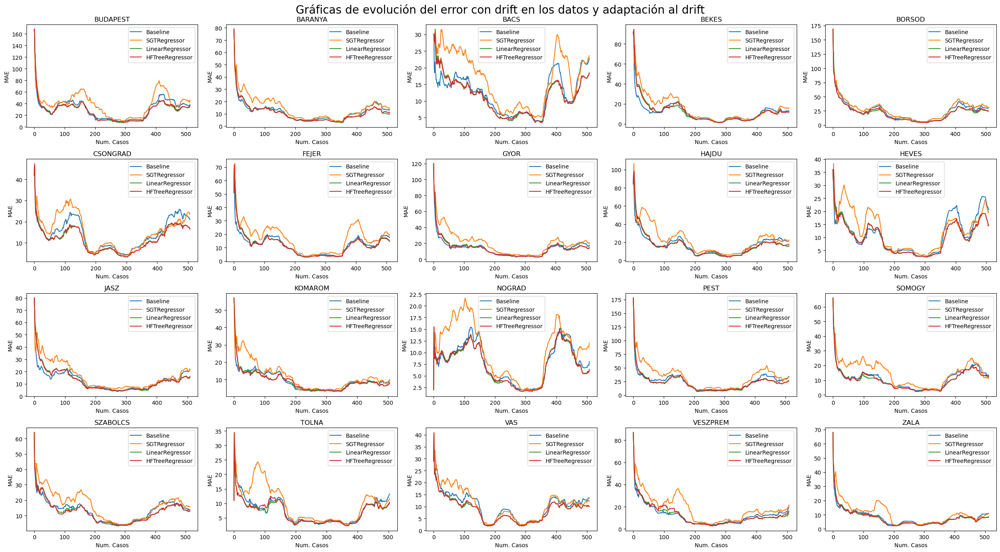

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        label=data_orig.columns[i]
        ax.set_title(label)
        df_error_mae_baseline_concept[label].plot(ax=ax)
        df_error_mae_stg_concept[label].plot(ax=ax)
        df_error_mae_linear_concept[label].plot(ax=ax)
        df_error_mae_hft_concept[label].plot(ax=ax)
        ax.legend(["Baseline", "SGTRegressor","LinearRegressor","HFTreeRegressor"]);
        ax.set_xlabel(label_num_casos)
        ax.set_ylabel("MAE")
        i += 1
fig.suptitle("Gráficas de evolución del error con drift en los datos y adaptación al drift", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.1.3.4.2 Gráficas de la evolución del error por regresor, con drift en los datos y sin usar detección y adaptación al drift.

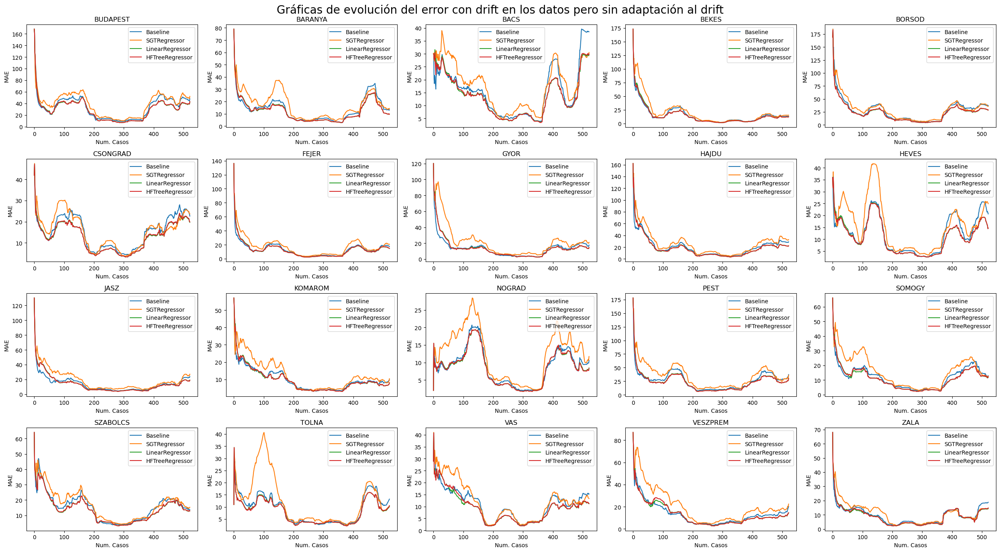

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        label=data_orig.columns[i]
        ax.set_title(label)
        df_error_mae_baseline[label].plot(ax=ax)
        df_error_mae_stg[label].plot(ax=ax)
        df_error_mae_linear[label].plot(ax=ax)
        df_error_mae_hft[label].plot(ax=ax)
        ax.legend(["Baseline", "SGTRegressor","LinearRegressor","HFTreeRegressor"]);
        ax.set_xlabel(label_num_casos)
        ax.set_ylabel("MAE")
        i += 1
fig.suptitle("Gráficas de evolución del error con drift en los datos pero sin adaptación al drift", fontsize=20)
plt.tight_layout()
plt.show()

### 2.1.5  Graficas de cada regresor **para cada ciudad** comparando la evolución del error contemplando el drift y adaptándose al drift o sin adaptarse.

##### 2.1.5.1  Hoeffding Tree Regressor, comparando la evolución del error con drift en los datos usando detección y adaptación al drift, y sin usar detección de drift.

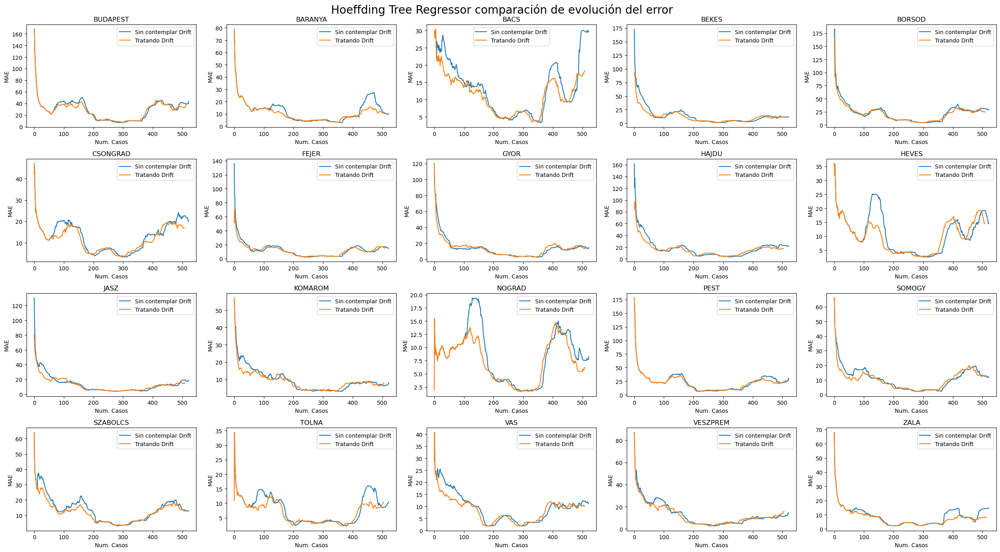

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        label=data_orig.columns[i]
        ax.set_title(label)
        df_error_mae_hft[label].plot(ax=ax)
        df_error_mae_hft_concept[label].plot(ax=ax)
        ax.legend(["Sin contemplar Drift", "Tratando Drift"]);
        ax.set_xlabel(label_num_casos)
        ax.set_ylabel("MAE")
        i += 1
fig.suptitle(" Hoeffding Tree Regressor comparación de evolución del error", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.1.5.2  Linear Regressor, comparando la evolución del error con drift en los datos usando detección y adaptación al drift, y sin usar detección de drift.

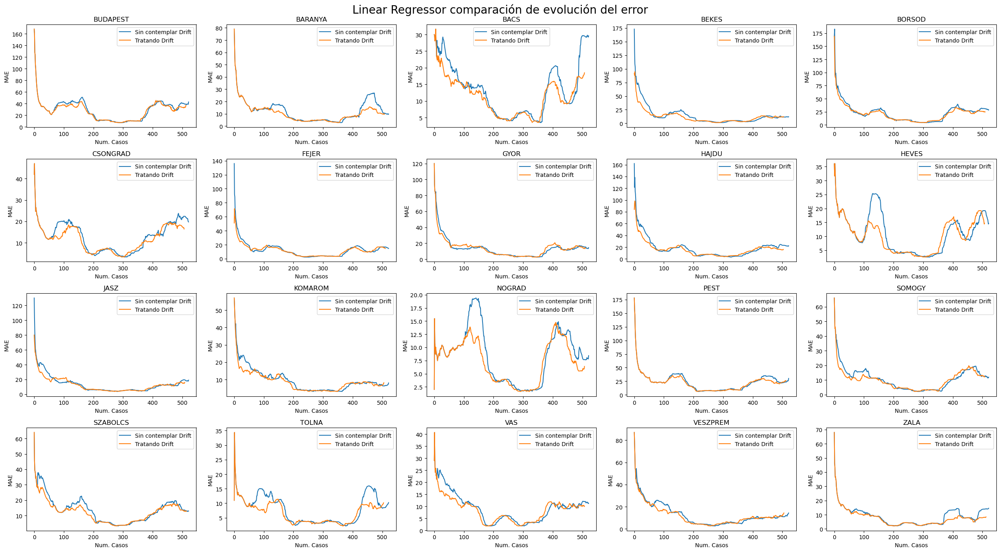

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        label=data_orig.columns[i]
        ax.set_title(label)
        df_error_mae_linear[label].plot(ax=ax)
        df_error_mae_linear_concept[label].plot(ax=ax)
        ax.legend(["Sin contemplar Drift", "Tratando Drift"]);
        ax.set_xlabel(label_num_casos)
        ax.set_ylabel("MAE")
        i += 1
fig.suptitle("Linear Regressor comparación de evolución del error", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.1.5.3  Stochastic Gradient Tree Regressor, comparando la evolución del error con drift en los datos usando detección y adaptación al drift, y sin usar detección de drift.

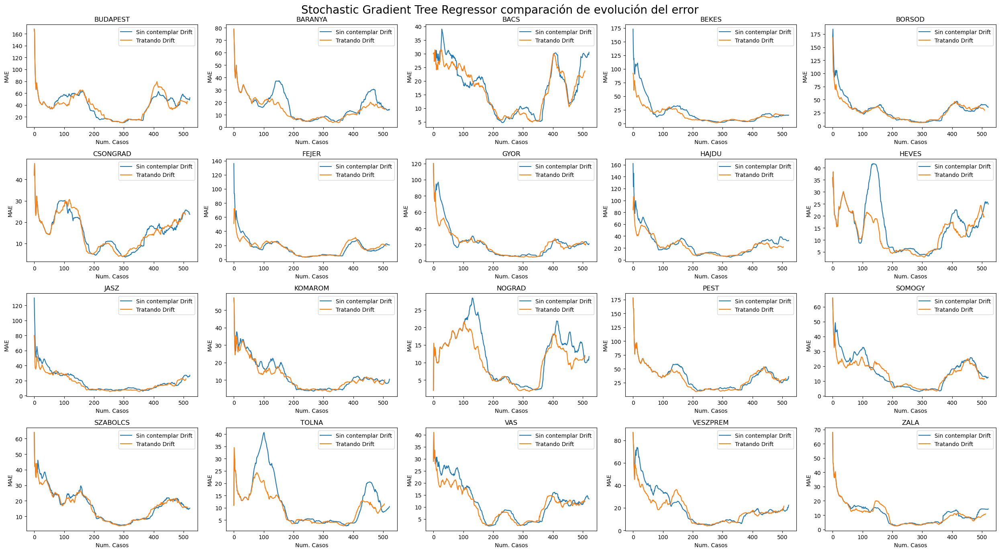

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        label=data_orig.columns[i]
        ax.set_title(label)
        df_error_mae_stg[label].plot(ax=ax)
        df_error_mae_stg_concept[label].plot(ax=ax)
        ax.legend(["Sin contemplar Drift", "Tratando Drift"]);
        ax.set_xlabel(label_num_casos)
        ax.set_ylabel("MAE")
        i += 1
fig.suptitle("Stochastic Gradient Tree Regressor comparación de evolución del error", fontsize=20)
plt.tight_layout()
plt.show()

##### 2.1.5.  Statistic Regressor (Dummy), comparando la evolución del error con drift en los datos usando detección y adaptación al drift, y sin usar detección de drift.

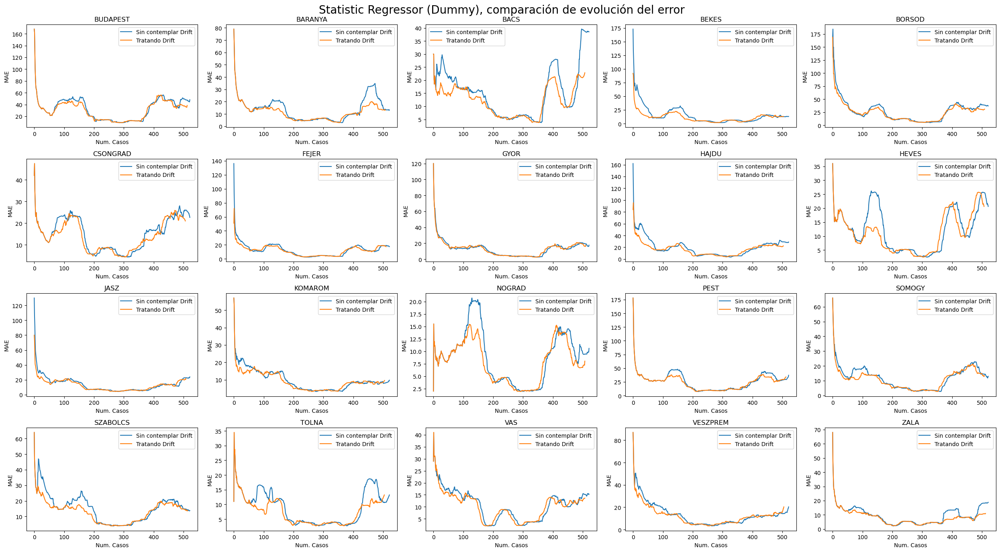

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        label=data_orig.columns[i]
        ax.set_title(label)
        df_error_mae_baseline[label].plot(ax=ax)
        df_error_mae_baseline_concept[label].plot(ax=ax)
        ax.legend(["Sin contemplar Drift", "Tratando Drift"]);
        ax.set_xlabel(label_num_casos)
        ax.set_ylabel("MAE")
        i += 1
fig.suptitle(" Statistic Regressor (Dummy), comparación de evolución del error", fontsize=20)
plt.tight_layout()
plt.show()

In [ ]:
"""from river import drift
 DAtos


drift_detector = drift.ADWIN()
drifts = []

for i, val in df_data_orig_drifted["BACS"].items():
    drift_detector.update(val)   # Data is processed one sample at a time
    if drift_detector.drift_detected:
        # The drift detector indicates after each sample if there is a drift in the data
        print(f"Change detected at index {i}, input value: {val}")
        drifts.append(i)

plot_data(df_data_orig_drifted["BACS"], drifts)"""

'from river import drift\n DAtos\n\n\ndrift_detector = drift.ADWIN()\ndrifts = []\n\nfor i, val in df_data_orig_drifted["BACS"].items():\n    drift_detector.update(val)   # Data is processed one sample at a time\n    if drift_detector.drift_detected:\n        # The drift detector indicates after each sample if there is a drift in the data\n        print(f"Change detected at index {i}, input value: {val}")\n        drifts.append(i)\n\nplot_data(df_data_orig_drifted["BACS"], drifts)'

### Tabla de resultados

In [ ]:
#Tabla con recopilación de los datos
df_datos.drop(columns=['Total_Casos']).sort_index(ascending=True)

,BUDAPEST,BARANYA,BACS,BEKES,BORSOD,CSONGRAD,FEJER,GYOR,HAJDU,HEVES,JASZ,KOMAROM,NOGRAD,PEST,SOMOGY,SZABOLCS,TOLNA,VAS,VESZPREM,ZALA
1 MAE Datos sin drift y sin tratar outliers base_line,48.1,13.25,38.54,13.02,37.21,22.63,17.58,17.65,28.94,20.62,23.94,9.81,10.6,37.19,12.94,13.79,13.23,15.27,20.33,18.81
1 MAE Datos sin drift y sin tratar outliers hft,43.35,9.79,29.93,11.93,28.64,19.94,14.73,14.42,22.13,14.67,19.0,8.1,8.29,30.44,12.19,12.99,10.5,11.23,14.64,14.8
1 MAE Datos sin drift y sin tratar outliers linear,42.75,9.79,29.59,12.0,28.6,19.73,14.64,14.46,22.25,14.65,19.14,8.04,8.44,30.2,11.98,12.92,10.24,11.18,14.39,14.55
1 MAE Datos sin drift y sin tratar outliers stg,50.96,14.39,30.51,16.69,37.2,23.59,20.65,17.5,30.1,21.96,27.11,10.77,11.77,39.3,12.57,15.34,10.48,13.34,22.86,18.15
2 MAE Datos sin drift y tratando outliers base_line,38.46,13.25,22.33,13.02,37.21,22.38,17.58,17.65,28.94,20.62,23.94,9.81,10.6,37.19,12.94,13.79,13.23,15.27,20.33,10.96
2 MAE Datos sin drift y tratando outliers hft,37.32,9.78,17.93,11.93,28.64,17.29,14.72,14.42,22.13,14.66,19.0,8.1,8.31,30.44,12.17,12.98,10.52,11.22,14.61,8.45
2 MAE Datos sin drift y tratando outliers linear,37.27,9.8,17.93,12.0,28.6,17.16,14.63,14.46,22.25,14.65,19.14,8.04,8.46,30.2,11.97,12.92,10.26,11.18,14.39,8.44
2 MAE Datos sin drift y tratando outliers stg,52.99,17.74,29.63,11.42,44.95,20.46,24.93,18.86,26.89,20.93,26.45,11.02,13.6,50.93,12.7,18.37,10.59,12.16,23.04,10.46
3 MAE Datos con drift y sin usar adaptacion al drift base_line,48.1,13.25,38.54,13.02,37.21,22.63,17.58,17.65,28.94,20.62,23.94,9.81,10.6,37.19,12.94,13.79,13.23,15.27,20.33,18.81
3 MAE Datos con drift y sin usar adaptacion al drift hft,43.35,9.79,29.93,11.93,28.64,19.94,14.73,14.42,22.13,14.67,19.0,8.1,8.29,30.44,12.19,12.99,10.5,11.23,14.64,14.8


In [ ]:
"""#evaluate_model(model_hft_reg)
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, 1]
        label=df_data_orig_drifted.columns[1]
        evaluate_model_without_outliers (model_hft_reg.clone(),df_data,label,ax,"hft")
        i += 1
        break
    break
plt.tight_layout()
plt.show()"""

'#evaluate_model(model_hft_reg)\nfig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))\ni = 0\nfor row in axes:\n    for ax in row:\n        df_data= df_data_orig_drifted.iloc[:, 1]\n        label=df_data_orig_drifted.columns[1]\n        evaluate_model_without_outliers (model_hft_reg.clone(),df_data,label,ax,"hft")\n        i += 1\n        break\n    break\nplt.tight_layout()\nplt.show()'

## 2.2 Predicciones a Largo Plazo
En este apartado vamos a realizar las tareas relacionadas con las Previsiones a largo Plazo. Aquí vamos a establecer dos horizontes temporales. Un horizonte temporal de 1 año y otro horizonte temporal de dos años.

## 2.3 Estimacion de la Incertidumbre, mediante regresión por cuantiles.
En este apartado vamos a estudiar una estimación de la incertidumbre, ya que muchas veces una predicción exacta puede no ser real por lo que se producirá un intervalo de prediccción para cada predicción.
Estos modelos son más robustos frente a outliers y son una forma de predecir relaciones entre variables que no tienen relación entre si o simplemtente tienen una relación débil.[Quantile Regression](https://medium.com/the-artificial-impostor/quantile-regression-part-1-e25bdd8d9d43).
Para ello vamos a tomar el mejor modelo de regresión de todos los que hemos análizado, el Modelo de Regresión Lineal y vamos a obtener estas "regiones de confianza". Además vamos a testear el comportamiento tanto con outliers como tratando los outliers.
Lo mismo vamos a hacer con el drift.


In [ ]:
def make_model(alpha):
    """Returns the model itself, using pipelines from riverML
    @alpha: quantile to be observed
    """

    extract_features = compose.TransformerUnion(get_ordinal_date, get_month_distances)

    scale = preprocessing.StandardScaler()

    learn = linear_model.LinearRegression(
        intercept_lr=0.,
        optimizer=optim.SGD(0.07),
        loss=optim.losses.Quantile(alpha=alpha)
    )
    
    model = extract_features | scale | learn
    model = preprocessing.TargetStandardScaler(regressor=model)

    return model
# Dataframe to store the values of the range for prediction interval
df_uncertainity=pd.DataFrame(columns=data_orig.columns)

def evaluate_uncertainity(df_data,ax, column,check_outliers):
  """
  Function for training the trhee models relative to the 3 quantiles
  lower, center and upper
  @df_data: data
  @ax: axis to plot the predictions
  @column: value to store the values in the dataframe df_uncertainity
  @check_outliers: [True|False] if outliers has to be checked or not
  """
  metric = metrics.MAE()

  models = {
      'lower': make_model(alpha=0.05),
      'center': make_model(alpha=0.5),
      'upper': make_model(alpha=0.95)
  }

  dates = []
  y_trues = []
  y_preds = {
      'lower': [],
      'center': [],
      'upper': []
  }
  media=df_data.mean()
  stdev=df_data.std()
  outlier_value= media + (3*stdev)
  for x, y in df_data.T.items():
    if  check_outliers:
        if y <= outlier_value:
          y_trues.append(y)
          dates.append(x)

          for name, model in models.items():
              y_preds[name].append(model.predict_one(x))
              model.learn_one(x, y)

          # Update the error metric
          metric.update(y, y_preds['center'][-1])
    else:
          y_trues.append(y)
          dates.append(x)

          for name, model in models.items():
              y_preds[name].append(model.predict_one(x))
              model.learn_one(x, y)

          # Update the error metric
          metric.update(y, y_preds['center'][-1])

  # Plot the results
  if check_outliers:
    df_uncertainity.at['1 Max Upper limit handling outliers', column] = round(max(y_preds['upper']),2)
    df_uncertainity.at['1 Mean Upper limit handling outliers', column] = round(sum(y_preds['upper'])/len(y_preds['upper']),2)
    df_uncertainity.at['1 Mean Center limit handling outliers', column] = round(sum(y_preds['center'])/len(y_preds['center']),2)
    df_uncertainity.at['1 Mean Lower limit handling outliers', column] = round(sum(y_preds['lower'])/len(y_preds['lower']),2)
    df_uncertainity.at['1 Min Lower limit handling outliers', column] = round(min(y_preds['lower']),2)
    df_uncertainity.at['1 MAE Handling outliers', column] = round(metric.get(),2)
   
  else:
    df_uncertainity.at['2 Max Upper limit without handling outliers', column] = round(max(y_preds['upper']),2)
    df_uncertainity.at['2 Mean Upper limit without handling outliers', column] = round(sum(y_preds['upper'])/len(y_preds['upper']),2)
    df_uncertainity.at['2 Mean Center limit without handling outliers', column] = round(sum(y_preds['center'])/len(y_preds['center']),2)
    df_uncertainity.at['2 Mean Lower limit without handling outliers', column] = round(sum(y_preds['lower'])/len(y_preds['lower']),2)
    df_uncertainity.at['2 Min Lower limit without handling outliers', column] = round(min(y_preds['lower']),2)
    df_uncertainity.at['2 MAE Without Handling outliers', column] = round(metric.get(),2)

  ax.grid(alpha=0.75)
  ax.plot(dates, y_trues, lw=3, color='#2ecc71', alpha=0.8, label='Truth')
  ax.plot(dates, y_preds['center'], lw=3, color='#e74c3c', alpha=0.8, label='Prediction')
  ax.fill_between(dates, y_preds['lower'], y_preds['upper'], color='blue', alpha=0.3, label='Prediction interval')
  ax.legend()
  ax.set_title(metric)



In [ ]:
def evaluate_uncertainity_drift(df_data,ax, column,check_drift):
  """
  Function for training the trhee models relative to the 3 quantiles
  lower, center and upper
  @df_data: data
  @ax: axis to plot the predictions
  @column: value to store the values in the dataframe df_uncertainity
  @check_drift: [True|False] if drift has to be checked or not
  """
 
  drifts=[]
  metric = metrics.MAE()

  models = {
      'lower': make_model(alpha=0.05),
      'center': make_model(alpha=0.5),
      'upper': make_model(alpha=0.95)
  }

  dates = []
  y_trues = []
  y_preds = {
      'lower': [],
      'center': [],
      'upper': []
  }
  media=df_data.mean()
  stdev=df_data.std()
  outlier_value= media + (3*stdev)

  #contador de Drifts
  num_drifts = 0 
  drifts=[]

  if check_drift:
    #Inicializamos el detector de Drift
    drift_detector = drift.ADWIN()
    for x, y in df_data.T.items():
      drift_detector.update(y)

      #if y <= outlier_value:
      y_trues.append(y)
      dates.append(x)
      if drift_detector.drift_detected:
        drifts.append(x)
      for name, model in models.items():
          if not drift_detector.drift_detected:
            y_preds[name].append(model.predict_one(x))
            model.learn_one(x, y)
            
          else: #if drift detected
            #print("drift_detected")
            if name=='lower':
              #print("restarting lower")
              model = make_model(alpha=0.05)
            elif name=='center':
              #print("restarting center")
              model=make_model(alpha=0.5)
            elif name=="upper":
              #print("restarting uper")
              model=make_model(alpha=0.95)
            y_preds[name].append(model.predict_one(x))
            #model.learn_one(x, y)
      # Update the error metric
      metric.update(y, y_preds['center'][-1])

    drift_detector=drift.ADWIN() #reiniciamos el drift detector
  else:
      
      for x, y in df_data.T.items():
        
        #if y <= outlier_value:
            y_trues.append(y)
            dates.append(x)
            for name, model in models.items():
                y_preds[name].append(model.predict_one(x))
                model.learn_one(x, y)

            # Update the error metric
            metric.update(y, y_preds['center'][-1])
      


  # Plot the results
  if check_drift:
    df_uncertainity.at['3 Max Upper limit handling drift', column] = round(max(y_preds['upper']),2)
    df_uncertainity.at['3 Mean Upper limit handling drift', column] = round(sum(y_preds['upper'])/len(y_preds['upper']),2)
    df_uncertainity.at['3 Mean Center limit handling drift', column] = round(sum(y_preds['center'])/len(y_preds['center']),2)
    df_uncertainity.at['3 Mean Lower limit handling drift', column] = round(sum(y_preds['lower'])/len(y_preds['lower']),2)
    df_uncertainity.at['3 MAE  Handling drift', column] = round(metric.get(),2)
    df_uncertainity.at['3 Min Lower limit handling drift', column] = round(min(y_preds['lower']),2)
  else:
    df_uncertainity.at['4 Max Upper limit without handling drift', column] = round(max(y_preds['upper']),2)
    df_uncertainity.at['4 Mean Upper limit without handling drift', column] = round(sum(y_preds['upper'])/len(y_preds['upper']),2)
    df_uncertainity.at['4 Mean Center limit without handling drift', column] = round(sum(y_preds['center'])/len(y_preds['center']),2)
    df_uncertainity.at['4 Mean Lower limit without handling drift', column] = round(sum(y_preds['lower'])/len(y_preds['lower']),2)
    df_uncertainity.at['4 MAE Without handling drift', column] = round(metric.get(),2)
    df_uncertainity.at['4 Min Lower limit without handling drift', column] = round(min(y_preds['lower']),2)

  if drifts is not None:
      for drift_detected in drifts:
              ax.axvline(drift_detected, color='red')
  ax.grid(alpha=0.75)
  ax.plot(dates, y_trues, lw=3, color='#2ecc71', alpha=0.8, label='Truth')
  ax.plot(dates, y_preds['center'], lw=3, color='#e74c3c', alpha=0.8, label='Prediction')
  ax.fill_between(dates, y_preds['lower'], y_preds['upper'], color='blue', alpha=0.3, label='Prediction interval')
  ax.set_xlabel(column)
  ax.legend()
  ax.set_title(metric)

### 2.3.1 Testing the model without handling outliers

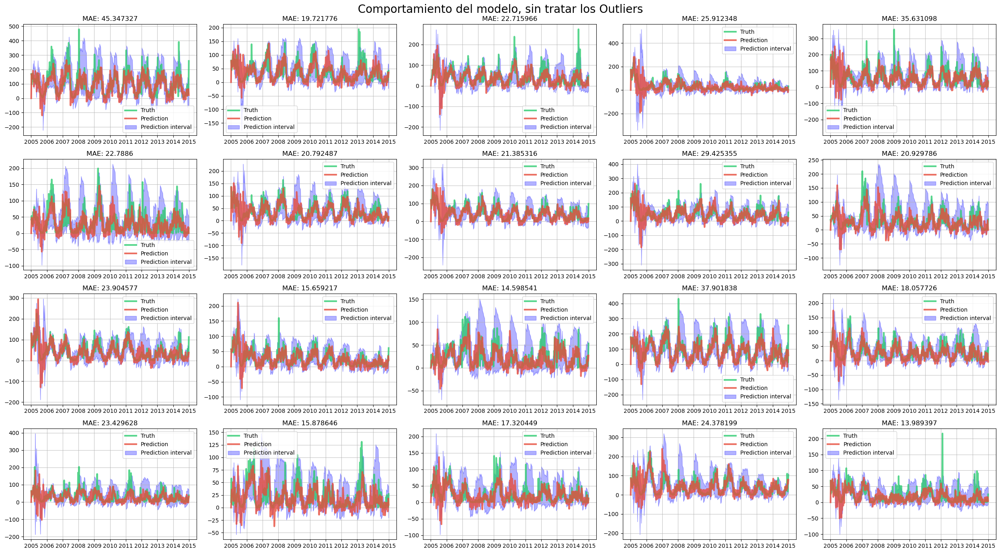

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        label=data_orig.columns[i]
        evaluate_uncertainity(df_data,ax,label,check_outliers=False)
        i += 1
fig.suptitle("Comportamiento del modelo, sin tratar los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

### 2.3.2 Testing the model handling outliers 

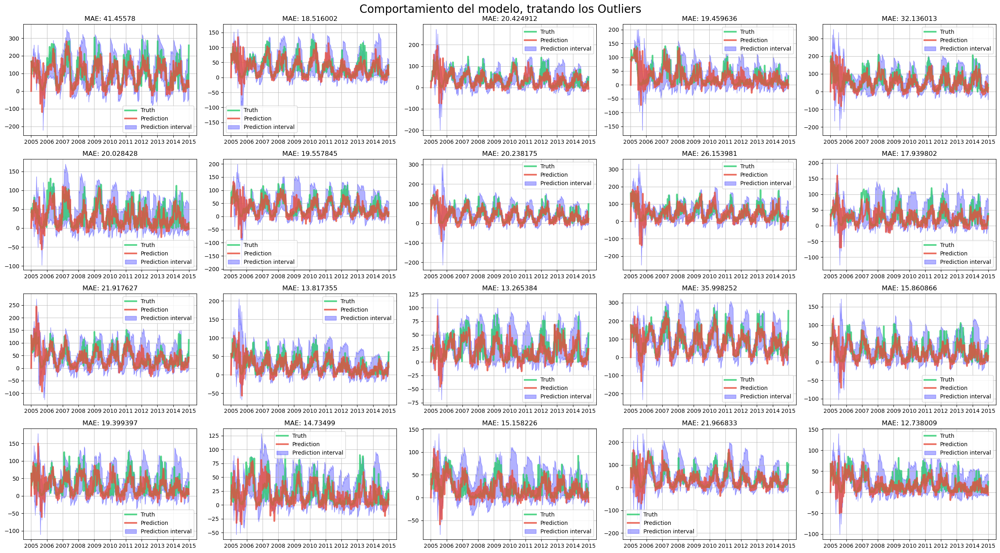

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= data_orig.iloc[:, i]
        label=data_orig.columns[i]
        evaluate_uncertainity(df_data,ax,label,check_outliers=True)
        i += 1
fig.suptitle("Comportamiento del modelo, tratando los Outliers", fontsize=20)
plt.tight_layout()
plt.show()

### 2.3.1 Testing the model without handling concept drift

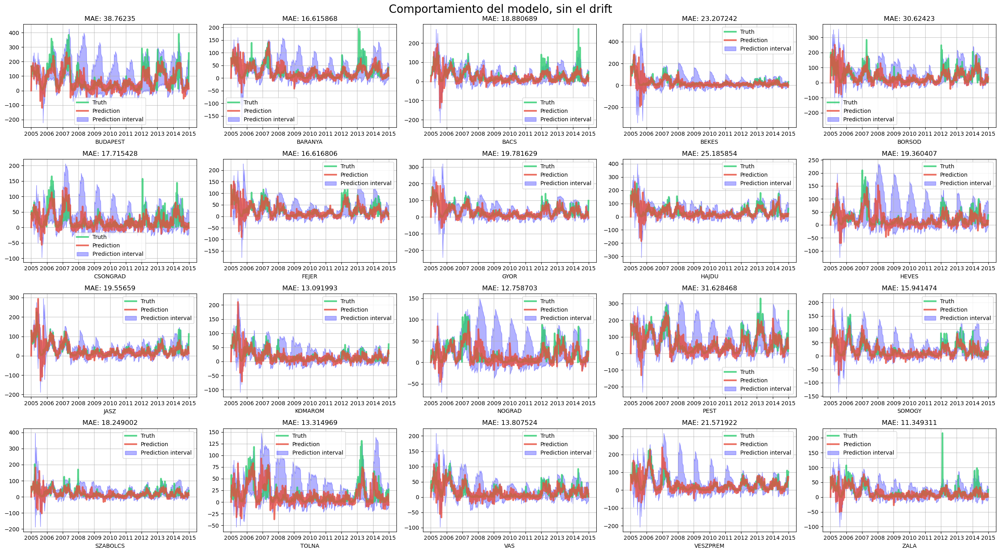

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        label=data_orig.columns[i]
        evaluate_uncertainity_drift(df_data,ax,label,check_drift=False)
        i += 1
        
    
fig.suptitle("Comportamiento del modelo, sin el drift", fontsize=20)
plt.tight_layout()
plt.show()

### 2.3.3 Testing the model handling concept drift

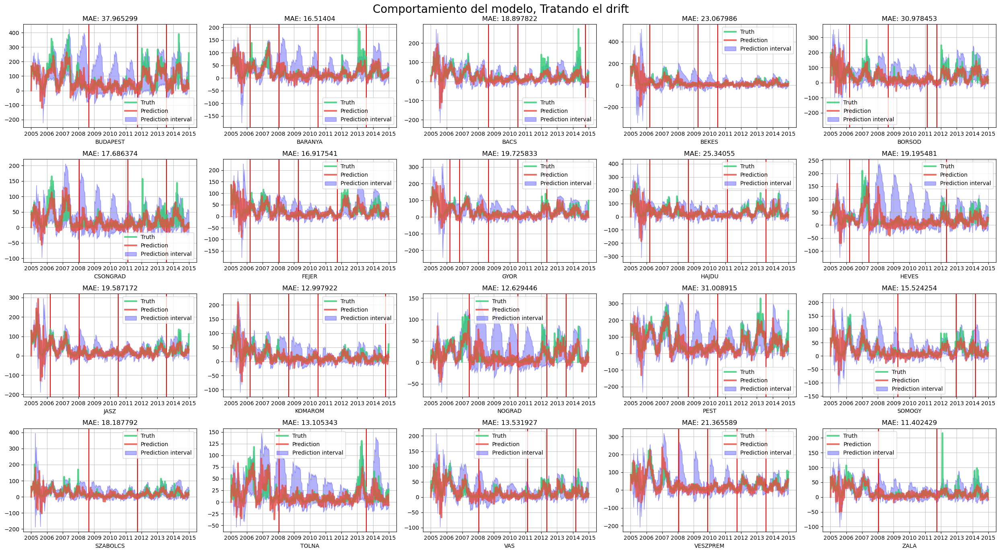

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=5, figsize=(25, 14))
i = 0
for row in axes:
    for ax in row:
        df_data= df_data_orig_drifted.iloc[:, i]
        label=data_orig.columns[i]
        evaluate_uncertainity_drift(df_data,ax,label,check_drift=True)
        i += 1
        
    
fig.suptitle("Comportamiento del modelo, Tratando el drift", fontsize=20)
plt.tight_layout()
plt.show()

In [ ]:
df_uncertainity.drop(columns=['Total_Casos']).sort_index(ascending=True)

,BUDAPEST,BARANYA,BACS,BEKES,BORSOD,CSONGRAD,FEJER,GYOR,HAJDU,HEVES,JASZ,KOMAROM,NOGRAD,PEST,SOMOGY,SZABOLCS,TOLNA,VAS,VESZPREM,ZALA
1 MAE Handling outliers,41.46,18.52,20.42,19.46,32.14,20.03,19.56,20.24,26.15,17.94,21.92,13.82,13.27,36.0,15.86,19.4,14.73,15.16,21.97,12.74
1 Max Upper limit handling outliers,350.35,160.75,272.57,200.94,351.88,169.4,199.61,302.51,329.84,196.71,275.36,205.87,116.36,322.3,171.68,178.48,129.03,140.93,238.46,140.19
1 Mean Center limit handling outliers,92.53,32.68,34.61,26.07,53.65,28.2,30.87,39.94,44.95,25.38,38.61,23.7,20.48,84.26,24.77,27.86,18.45,19.86,37.42,17.23
1 Mean Lower limit handling outliers,26.16,2.95,1.6,-7.15,4.62,-3.04,1.3,9.6,4.2,-1.11,2.15,3.41,0.89,24.79,2.66,-1.77,-1.55,-2.46,1.28,-1.89
1 Mean Upper limit handling outliers,183.62,70.91,77.72,67.16,115.31,70.85,75.85,83.5,95.15,69.78,86.29,59.56,50.81,158.71,61.01,71.03,51.17,57.16,88.53,51.08
1 Min Lower limit handling outliers,-222.06,-176.28,-200.16,-163.51,-218.12,-97.45,-184.61,-212.75,-251.01,-125.2,-125.54,-67.42,-69.57,-233.61,-102.44,-110.57,-53.37,-80.91,-206.31,-100.88
2 MAE Without Handling outliers,45.35,19.72,22.72,25.91,35.63,22.79,20.79,21.39,29.43,20.93,23.9,15.66,14.6,37.9,18.06,23.43,15.88,17.32,24.38,13.99
2 Max Upper limit without handling outliers,426.0,162.56,272.57,516.79,356.2,212.52,228.33,319.71,401.23,235.54,295.81,223.38,151.11,359.96,215.4,395.65,147.52,209.16,319.49,140.19
2 Mean Center limit without handling outliers,91.98,35.32,35.43,27.99,55.5,29.73,33.66,40.8,46.13,28.82,40.12,24.83,21.04,83.83,27.23,27.31,19.26,21.93,41.43,18.14
2 Mean Lower limit without handling outliers,26.53,1.74,-0.6,-12.87,6.13,-5.51,0.95,6.24,1.91,-2.97,2.39,0.62,-1.29,24.02,0.7,-5.84,-1.42,-4.52,-0.2,-2.29


### 2.3.4 Resultados Estimación de Incertidumbre


Para este apartado se ha escogido el modelo que mejor métricas a obtenido durante todos los apartados anteriores. Se ha escogido el Linear Regression aunque se ha modificado un poquito introduciendo el parametro *intercept_lr=0*, para que no coja ningun valor por defecto. Este valor está por defecto a 0.01.
* Outliers: Se ha visto claramente en la tabla de resultados que para el tratamiento de outliers, la zona de confianza parametrizada con los siguientes parámetros   models = {
      'lower': make_model(alpha=0.05),
      'center': make_model(alpha=0.5),
      'upper': make_model(alpha=0.95)
  } se ha reducido el el rango entre el límite superior y el límite inferior, además de que el modelo produce mejor métrica MAE. Con lo cual el tratamiento de outliers ,sí mejora tanto la precisión del Modelo como la zona de confianza para predicciones individuales.

* Concept Drift: Pare el Concept Drift no es tan clara la mejoría, aunque esta sí existe aunque menos notoria que con el tratamiento de outliers por que a primera vista los rangos de la zona de confianza, Max limite superior y Min límite inferior, son iguales, sí se puede apreciar que el modelo obtiene una métrica MAE mejorada y las medias de tanto los limites inferior y superior también mejoran, aunque no tanto como en el tratamiento de outliers.

Estos resultados, son así por que el Intervalo de Prediccion (zona de confianza)predice la distribución de valores futuros **individualmente**.
Mientras que el Intervalo de Confianza,relativo a las métricas en este caso, MAE estima la media de la población apoyandose en valores anteriores. Por eso la métrica mejora al manejar el concept drift, hace que el modelo produzca mejor métrica, no así tanto en la zona de confianza. Sin embargo al tratar los outliers ya se están eliminando los valores extremos, reduciendo así la zona de confianza y los valores de la métrica MAE.